# Imports

In [2]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
import pandas as pd

from fastai.vision import *
from fastai.vision.models.xresnet import *

# for datablock API
from fastai.vision.image import _resolve_tfms, _get_crop_target, _round_multiple, _get_resize_target, _affine_grid, _grid_sample, _affine_mult

# for AdvXResNet
from fastai.vision.models.xresnet import act_fn, init_cnn, conv, noop, conv_layer, ResBlock, filt_sz


In [4]:
import pdb

In [5]:
__version__

'1.0.56.dev0'

In [42]:
# from https://github.com/oguiza/fastai_extensions/blob/master/shared/0_image_data_augmentation/exp/nb_new_data_augmentation.py
#def show_single_img_tfms(learn, rows=3, cols=3, figsize=(8, 8)):
#    img = learn.data.train_ds.x
#    tfms = learn.data.train_ds.tfms
#    rand_int = np.random.randint(len(img))
#    [img[rand_int].apply_tfms(tfms).show(ax=ax) for i, ax in enumerate(
#            plt.subplots(rows, cols, figsize=figsize)[1].flatten())]
#    plt.show()
#    return learn
#
#
#Learner.show_single_img_tfms = show_single_img_tfms

# 6D image test

In [7]:
class Image6D(Image):
    "Support applying transforms to image data in `px`."
    def __init__(self, px:Tensor):
        self._px = px
        self._logit_px=None
        self._flow=None
        self._affine_mat=None
        self.sample_kwargs = {}

    def _repr_image_format(self, format_str):
        with BytesIO() as str_buffer:
            #plt.imsave(str_buffer, image2np(self.px[:3]), format=format_str)
            plt.imsave(str_buffer, 
                       np.concatenate((image2np(self.px[:3]), 
                                       image2np(self.px[3:])), axis=1),
                       format=format_str)
            return str_buffer.getvalue()

In [8]:
def open_image_6D(fn:PathOrStr, div:bool=True, convert_mode:str='L', cls:type=Image6D,
        after_open:Callable=None)->Image:
    "Return `Image` object created from image in file `fn`."
    with warnings.catch_warnings():
        warnings.simplefilter("ignore", UserWarning) # EXIF warning from TiffPlugin
        
        x = []
        for i in range(6):
            c = PIL.Image.open(fn+'_w'+str(i+1)+'.png').convert(convert_mode)
            if after_open: c = after_open(c)
            c = np.asarray(c)
            c = torch.from_numpy(c.astype(np.float32, copy=False))
            x.append(c)
            
    x = torch.stack(x)
    if div: x.div_(255)
    return cls(x)

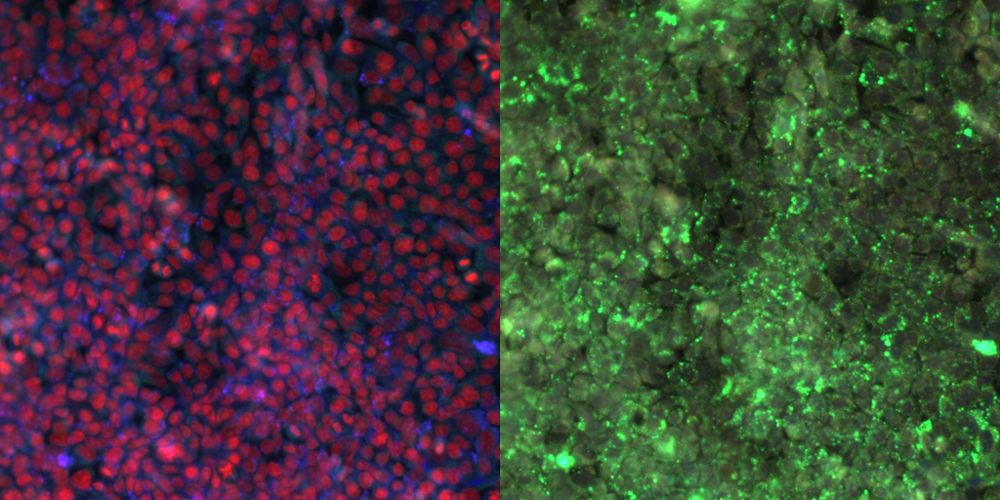

In [9]:
PATH_trunc = 'train/HEPG2-01/Plate1/B02_s1' # path is missing suffix "_w1.png"
open_image_6D(PATH_trunc)

# Dataset setup

In [10]:
class ImageList6D(ImageList): #ImageList
    def __init__(self, *args, convert_mode='L', after_open:Callable=None, **kwargs):
        super().__init__(*args, **kwargs)
        self.convert_mode,self.after_open = convert_mode,after_open
        self.copy_new.append('convert_mode')
        self.c,self.sizes = 6,{}
        
    def open(self, fn):
        "Open image in `fn`, subclass and overwrite for custom behavior."
        return open_image_6D(fn, convert_mode=self.convert_mode, after_open=self.after_open)

#    def show(self, img):
#        #return torch.cat((img[i][:3], img[i][3:]), dim=1)
#        show_image(img)
    
    # https://docs.fast.ai/tutorial.itemlist.html#Advanced-show-methods
    def show_xys(self, xs, ys, figsize:Tuple[int,int]=(15,10), **kwargs):
        "Show the `xs` and `ys` on a figure of `figsize`. `kwargs` are passed to the show method."
        rows = int(math.sqrt(len(xs)))
        fig, axs = plt.subplots(rows,rows,figsize=figsize)
        for i, ax in enumerate(axs.flatten() if rows > 1 else [axs]):
            #xs[i].show(ax=ax, y=ys[i], **kwargs)
            img = Image6D(torch.cat((xs[i].data[:3], xs[i].data[3:]), dim=2)) # works but not elegant?
            #img = Image6D(xs[i]) # does not work?
            img.show(ax=ax, y=ys[i], **kwargs)
        plt.tight_layout()

In [11]:
#def show_image(img:Image, ax:plt.Axes=None, figsize:tuple=(3,3), hide_axis:bool=True, cmap:str='binary',
#                alpha:float=None, **kwargs)->plt.Axes:
#    "Display `Image` in notebook."
#    if ax is None: fig,ax = plt.subplots(figsize=figsize)
#    pdb.set_trace()
#    #ax.imshow(image2np(img.data), cmap=cmap, alpha=alpha, **kwargs)
#    ax.imshow(np.concatenate((image2np(self.px[:3]),
#                              image2np(self.px[3:])), axis=1),
#              cmap=cmap, alpha=alpha, **kwargs)
#    if hide_axis: ax.axis('off')
#    return ax


## Full dataset

### Dataset parameters full dataset

In [12]:
df_train = pd.read_csv('full_train_dataset_valid-split-ex_v1_20190714.csv', index_col=0)
df_test = pd.read_csv('full_test_dataset_v1_20190714.csv', index_col=0)

In [13]:
df_train.head()

,path,experiment,sirna,multi,valid
0,HEPG2-01/Plate1/B03_s1,HEPG2-01,513,HEPG2-01 513,0
1,HEPG2-01/Plate1/B04_s1,HEPG2-01,840,HEPG2-01 840,0
2,HEPG2-01/Plate1/B05_s1,HEPG2-01,1020,HEPG2-01 1020,0
3,HEPG2-01/Plate1/B06_s1,HEPG2-01,254,HEPG2-01 254,0
4,HEPG2-01/Plate1/B07_s1,HEPG2-01,144,HEPG2-01 144,0


In [14]:
df_test.head()

,path,experiment
0,HEPG2-08/Plate1/B03_s1,HEPG2-08
1,HEPG2-08/Plate1/B04_s1,HEPG2-08
2,HEPG2-08/Plate1/B05_s1,HEPG2-08
3,HEPG2-08/Plate1/B06_s1,HEPG2-08
4,HEPG2-08/Plate1/B07_s1,HEPG2-08


In [15]:
sz, bs = 512, 8

In [16]:
sz, bs

(512, 8)

### Color augmentation transformation

"Color Augmentation: Color variability can be increased by applying random color transformations to original training samples. We perform color augmentation by transforming every color channels Ic ← ac · Ic + bc, where ac and bc are drawn from uniform distributions ac ∼ U [0.9, 1.1] and bc ∼ U [−10, +10]." from Domain-adversarial neural networks to address the appearance variability of histopathology images

In [17]:
# from https://github.com/fastai/fastai/blob/master/fastai/vision/transform.py#L137
#def _rgb_randomize(x, channel:int=None, thresh:float=0.3):
#    "Randomize one of the channels of the input image"
#    if channel is None: channel = np.random.randint(0, x.shape[0] - 1)
#    x[channel] = torch.rand(x.shape[1:]) * np.random.uniform(0, thresh)
#    return x
#
#rgb_randomize = TfmPixel(_rgb_randomize)

In [18]:
# Scaling factor comes from byte tensor?
#10/255 = 0.0392156862745098

In [19]:
def _color_augmentation(x):
    "Randomize all channels of the input image"
    channel_count = x.shape[0] - 1
    
    # by transforming every color channels Ic ← ac · Ic + bc, 
    # where ac and bc are drawn from uniform distributions 
    # ac ∼ U [0.9, 1.1] and 
    # bc ∼ U [−10, +10].
    
    # x [0,1]
    
    for c in range(channel_count):
        #pdb.set_trace()
        #print(x.min(), x.max())
        ac = np.random.uniform(0.9, 1.1) #np.random.uniform(0.9, 1.1)
        bc = np.random.uniform(-0.1,0.1) #np.random.uniform(-10, 10)
        x[c] = x[c] * ac + bc
        
        # clipping to min 0 and max 1
        x[c] = torch.clamp(x[c], 0., 1.)
    
    return x

color_augmentation = TfmPixel(_color_augmentation)

In [20]:
def get_ex(): return open_image('imgs/cat_example.jpg')

def plots_f(rows, cols, width, height, **kwargs):
    [get_ex().apply_tfms(tfms[0], **kwargs).show(ax=ax) for i,ax in enumerate(plt.subplots(
        rows,cols,figsize=(width,height))[1].flatten())]

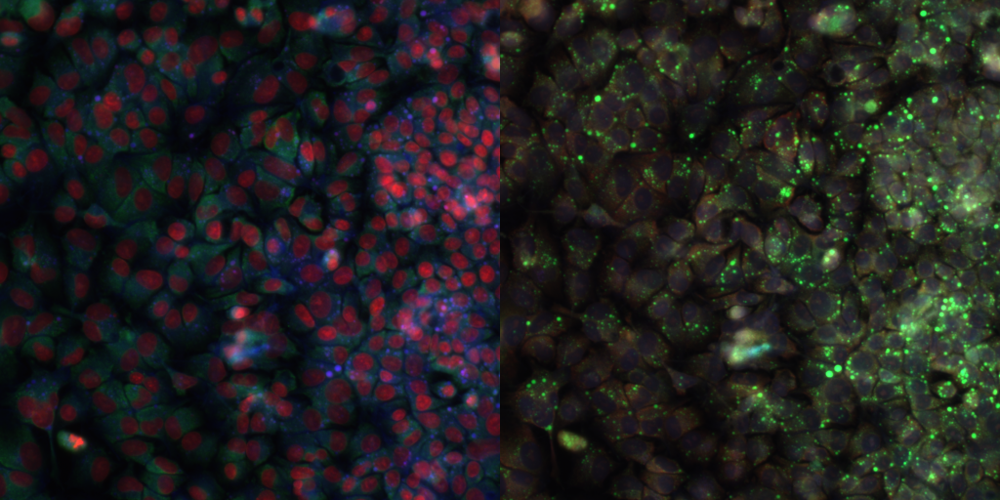

In [33]:
# original picture (if databunch is setup without tfms!)
data_a.train_ds[10][0]

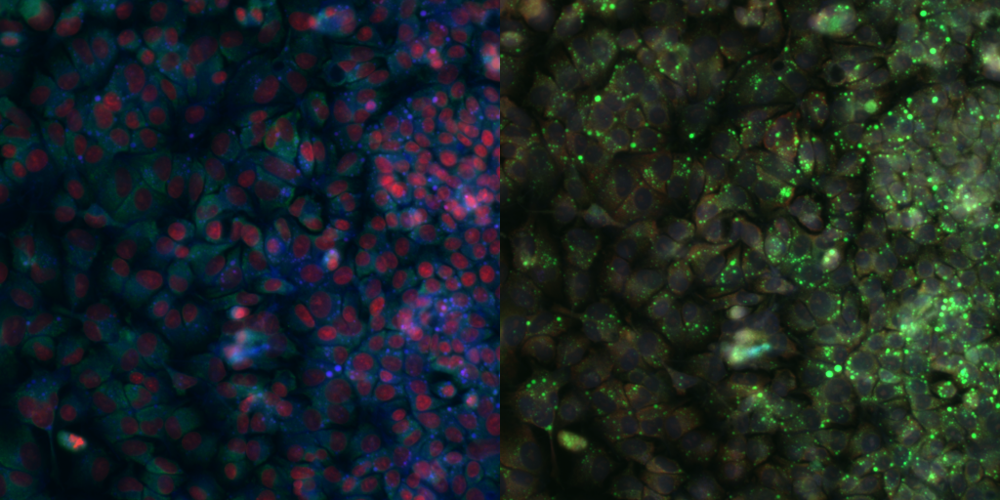

In [34]:
data_a.train_ds[10][0].color_augmentation()

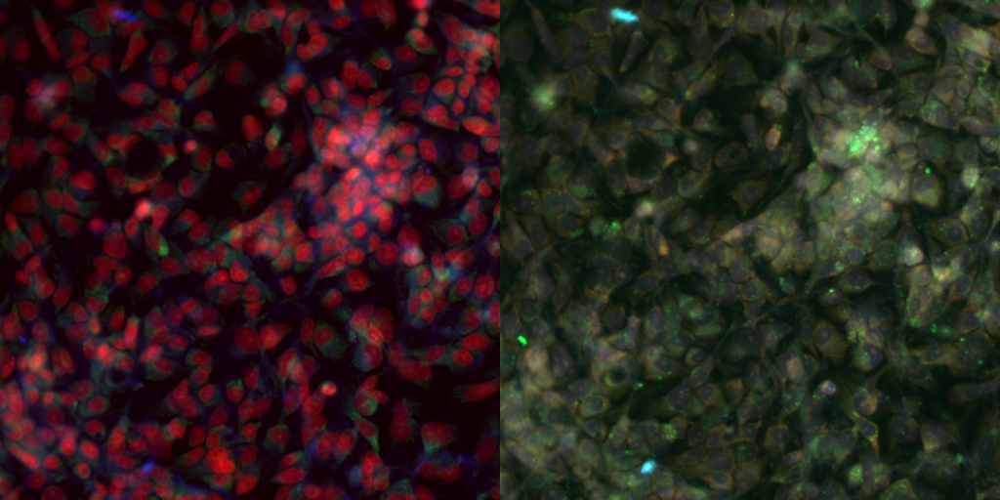

In [35]:
data_a.train_ds[0][0].color_augmentation()

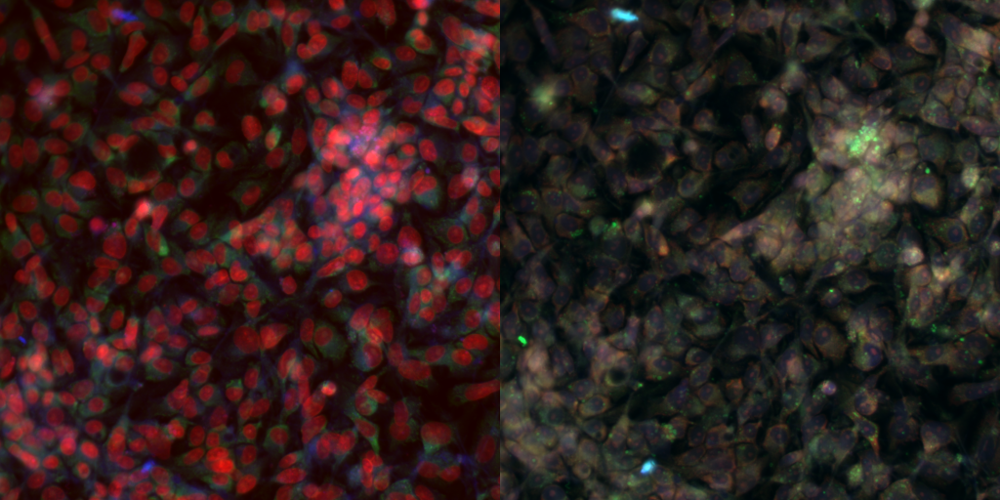

In [36]:
data_a.train_ds[0][0].color_augmentation()

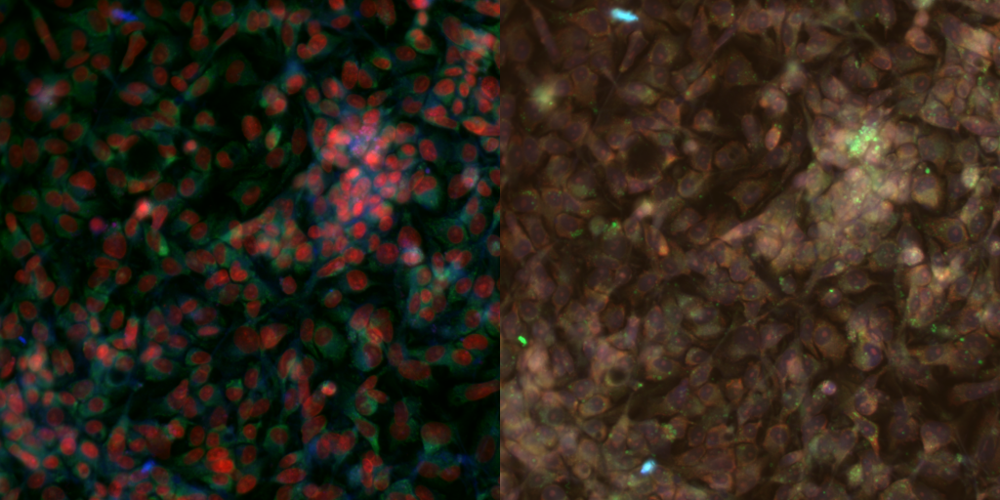

In [37]:
data_a.train_ds[0][0].color_augmentation()

In [39]:
learn = cnn_learner(data_a, models.resnet18)

In [41]:
#learn.show_single_img_tfms()

### Transforms setup

In [21]:
#tfms = get_transforms()
#tfms = get_transforms(xtra_tfms=color_augmentation())

### Adversarial full dataset

In [22]:
data_a = (ImageList6D.from_df(df_train, path='train')
          .split_none()
          #.split_from_df(col=-1)
          .label_from_df(cols=-2, label_delim=' ') # label_delim=' ' for MultiCategoryList !
          .add_test(ImageList6D.from_df(df_train, path='train'))
          .transform(size=sz)
          #.transform(tfms, size=sz) # TFMS!
          .databunch(bs=bs))

In [23]:
data_a

ImageDataBunch;

Train: LabelList (36515 items)
x: ImageList6D
Image6D (6, 512, 512),Image6D (6, 512, 512),Image6D (6, 512, 512),Image6D (6, 512, 512),Image6D (6, 512, 512)
y: MultiCategoryList
HEPG2-01;513,HEPG2-01;840,HEPG2-01;1020,HEPG2-01;254,HEPG2-01;144
Path: train;

Valid: LabelList (0 items)
x: ImageList6D

y: MultiCategoryList

Path: train;

Test: LabelList (36515 items)
x: ImageList6D
Image6D (6, 512, 512),Image6D (6, 512, 512),Image6D (6, 512, 512),Image6D (6, 512, 512),Image6D (6, 512, 512)
y: EmptyLabelList
,,,,
Path: train

In [24]:
data_a.c, len(data_a.classes), data_a.classes[-5:]

(1141, 1141, ['RPE-06', 'RPE-07', 'U2OS-01', 'U2OS-02', 'U2OS-03'])

In [25]:
data_a.batch_size

8

In [26]:
data_a.train_ds[0]

(Image6D (6, 512, 512), MultiCategory HEPG2-01;513)

In [27]:
#data_a.classes

In [28]:
data_a.train_ds[0][1], data_a.train_ds[0][1].data

(MultiCategory HEPG2-01;513,
 array([0., 0., 0., 0., ..., 0., 0., 0., 0.], dtype=float32))

In [29]:
data_a.train_ds[0][1].data.sum()

2.0

In [30]:
np.where(data_a.train_ds[0][1].data > 0.5)

(array([ 569, 1108]),)

In [31]:
[data_a.classes[j] for j in np.where(data_a.train_ds[0][1].data > 0.5)[0]]

['513', 'HEPG2-01']

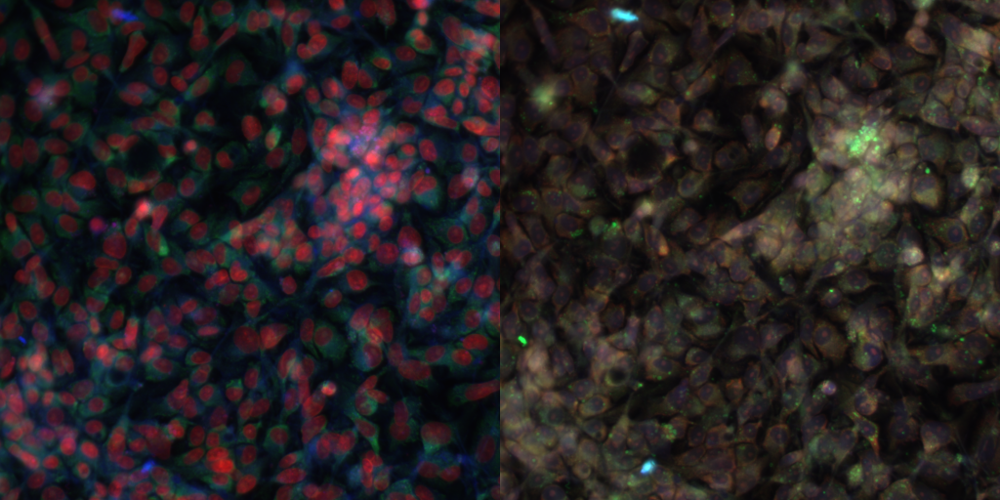

In [32]:
data_a.train_ds[0][0]

In [292]:
# DOES NOT WORK?
#data_a.train_ds[0][0].show()

# Inspect data

## Without tfms

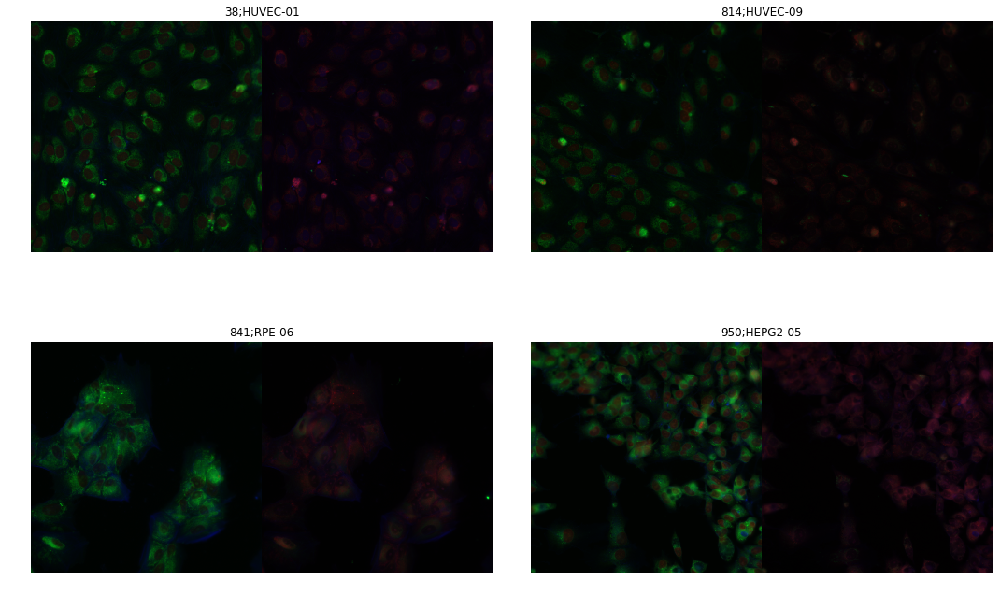

In [121]:
data_a.show_batch(rows=2)

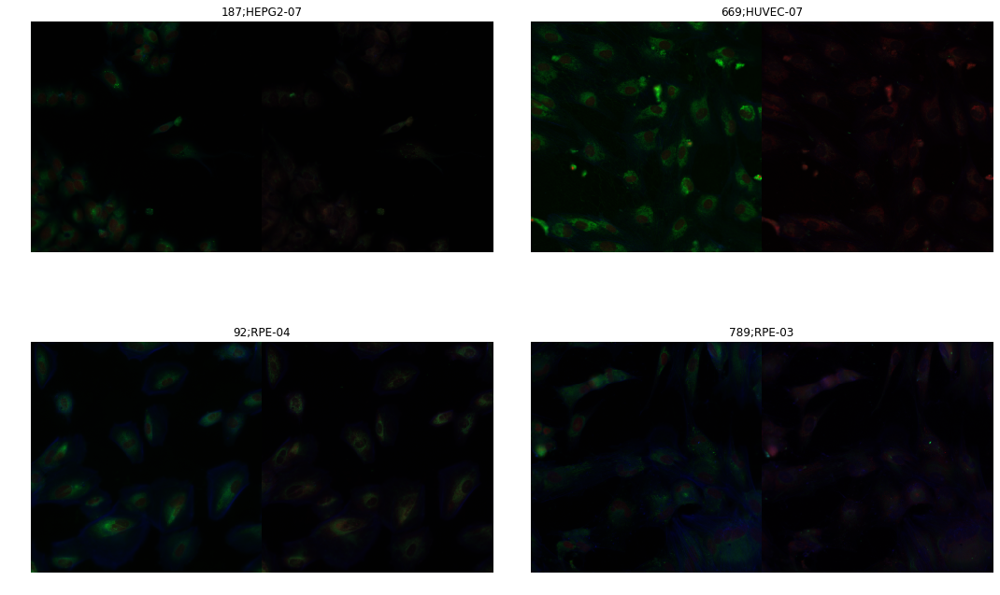

In [122]:
data_a.show_batch(rows=2)

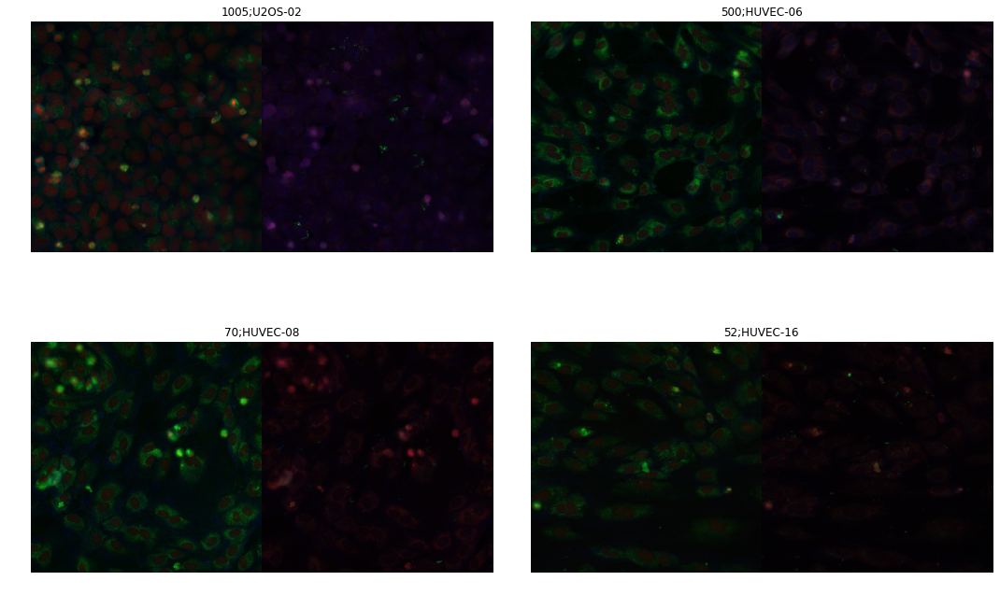

In [123]:
data_a.show_batch(rows=2)

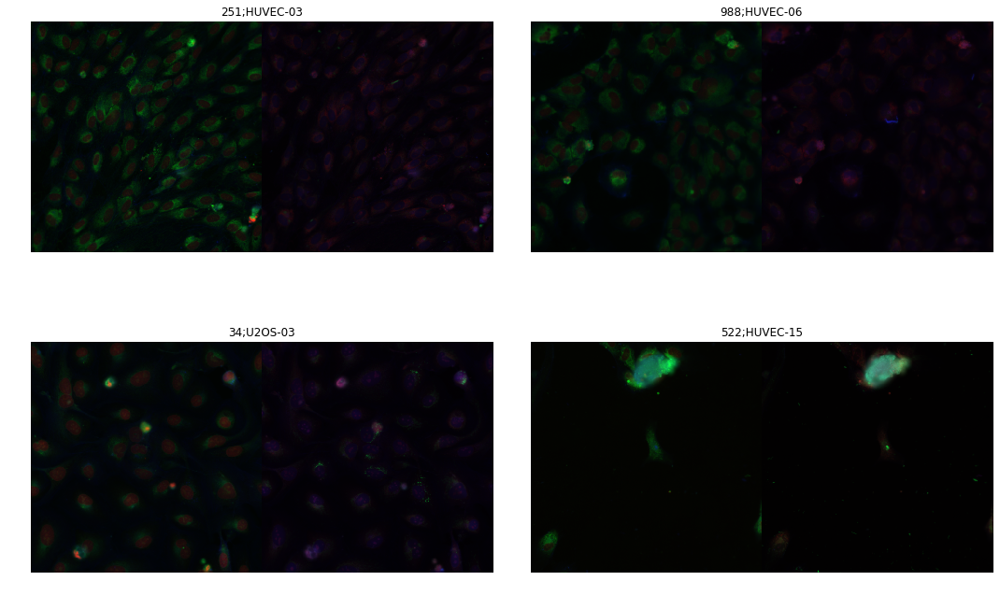

In [124]:
data_a.show_batch()

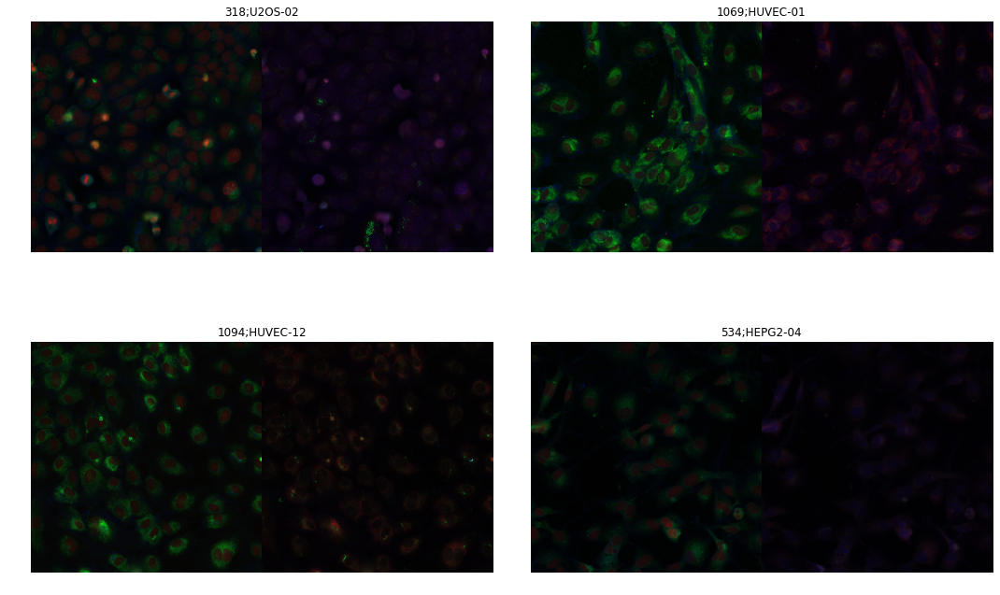

In [125]:
data_a.show_batch(rows=2)

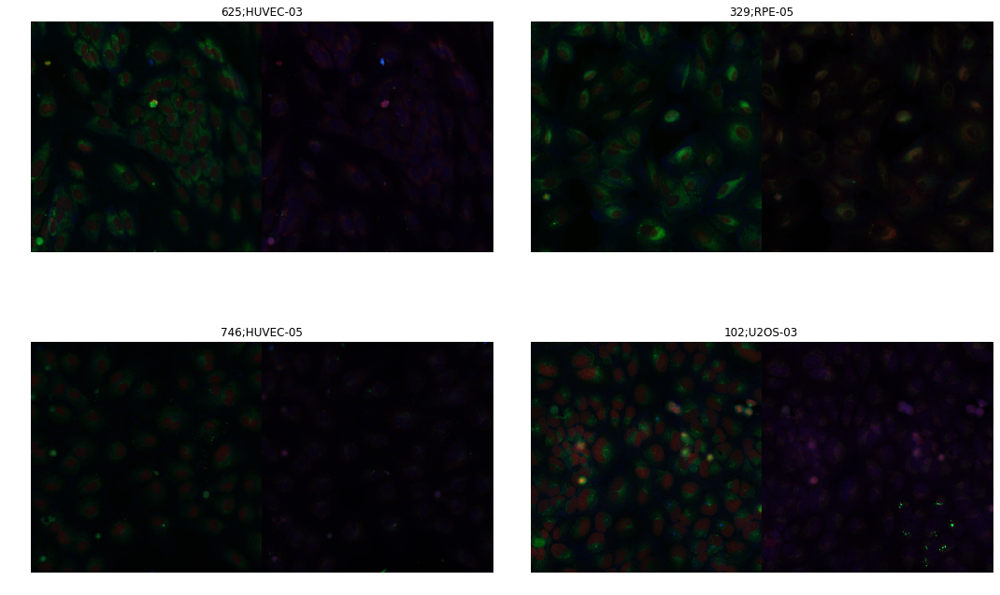

In [126]:
data_a.show_batch(rows=2)

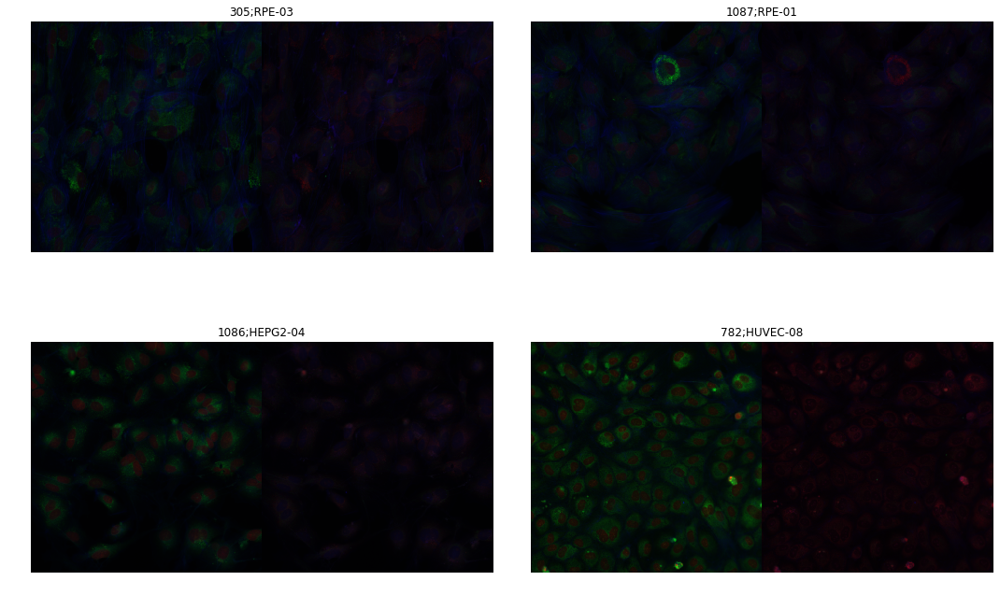

In [127]:
data_a.show_batch(rows=2)

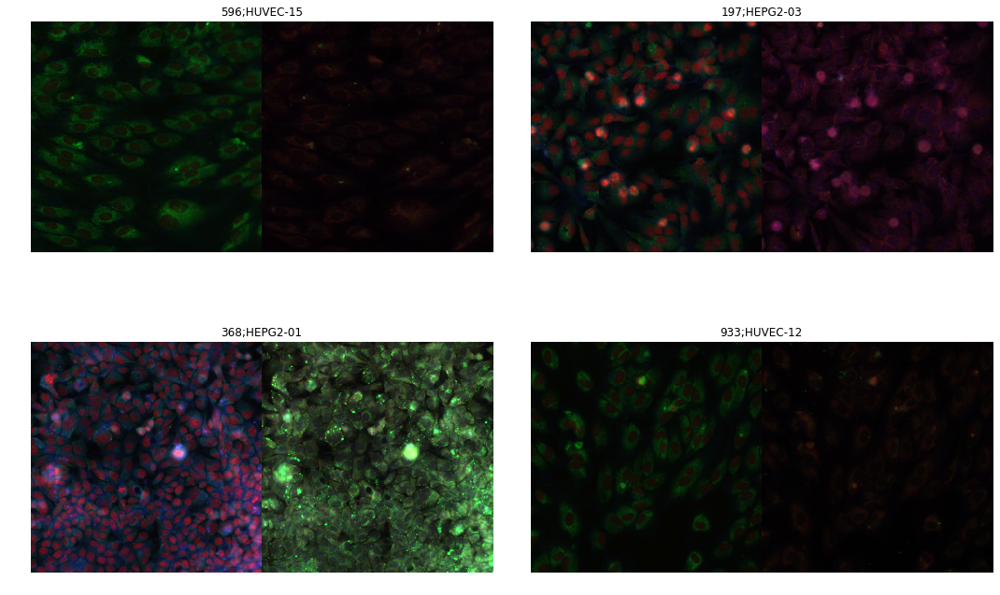

In [128]:
data_a.show_batch(rows=2)

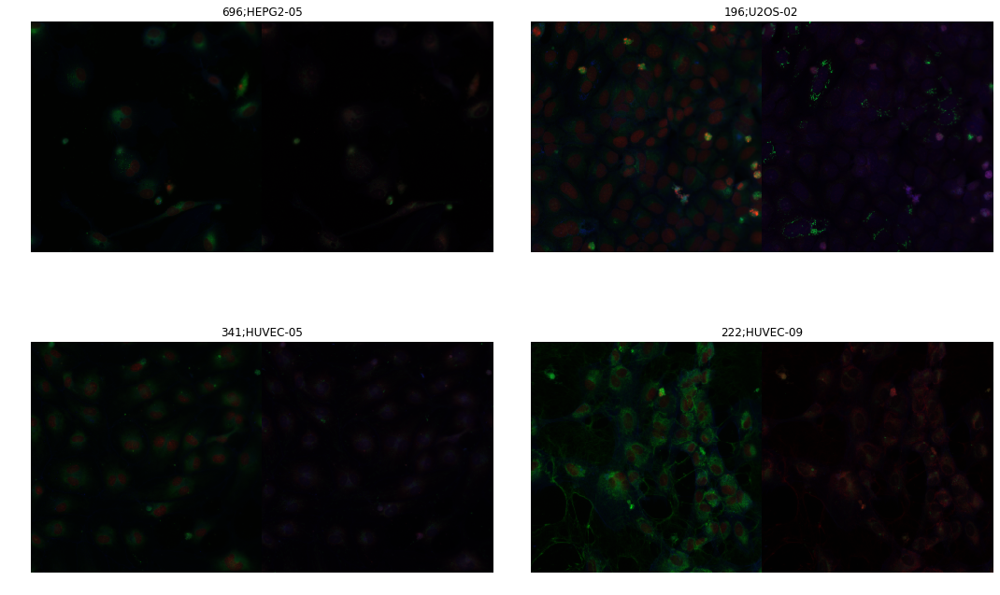

In [129]:
data_a.show_batch(rows=2)

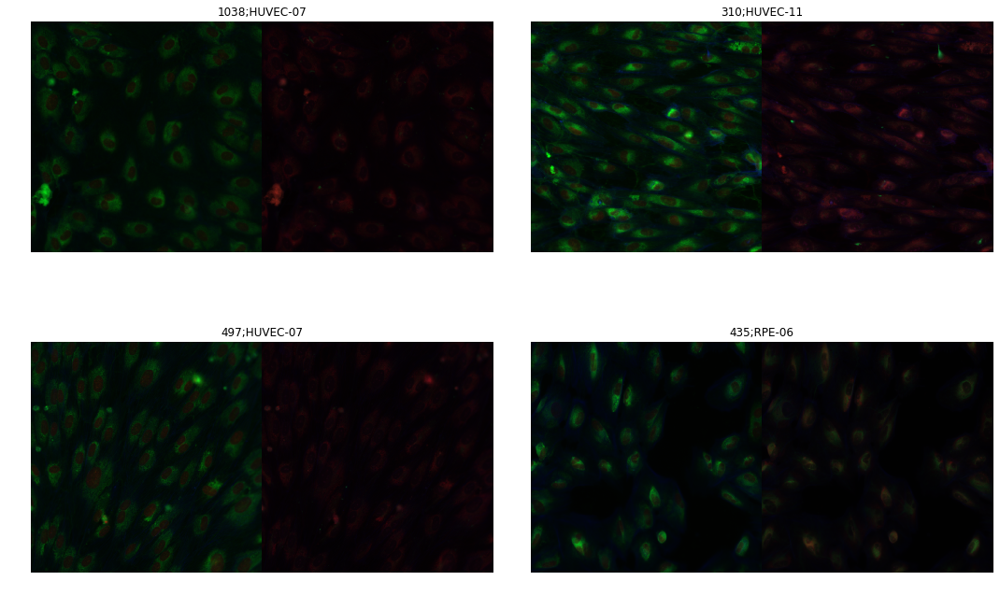

In [130]:
data_a.show_batch(rows=2)

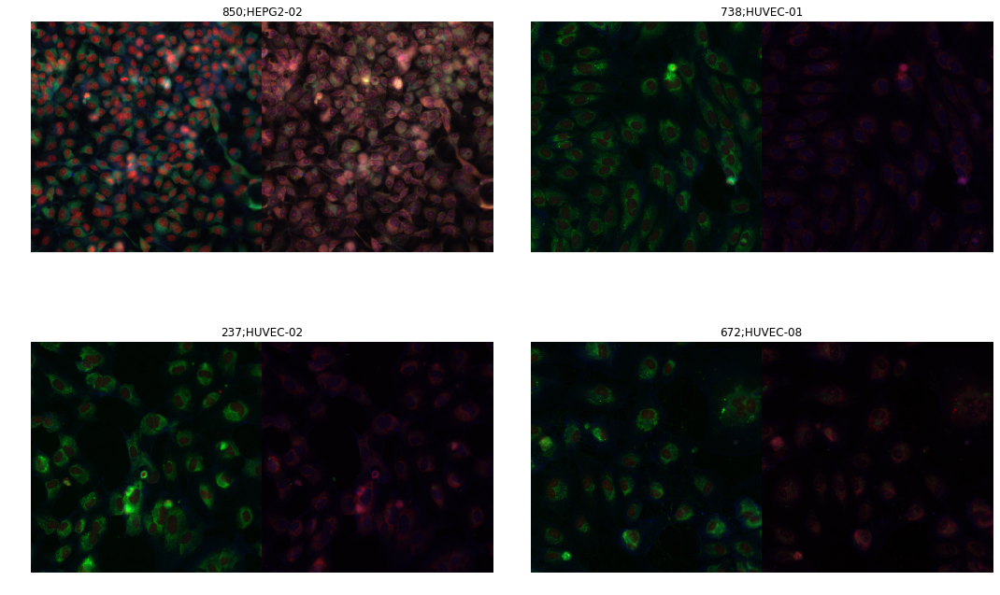

In [131]:
data_a.show_batch(rows=2)

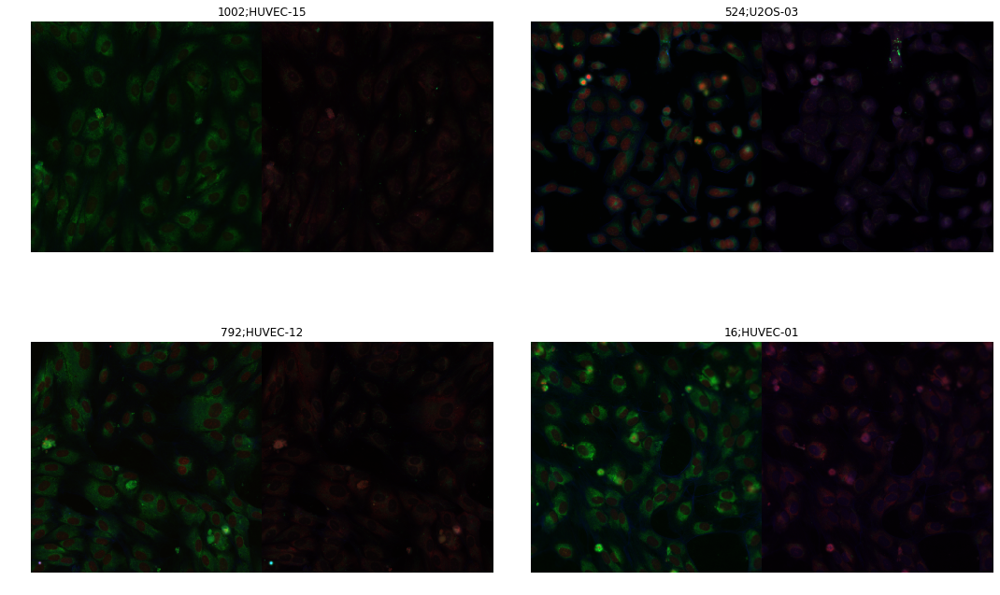

In [132]:
data_a.show_batch(rows=2)

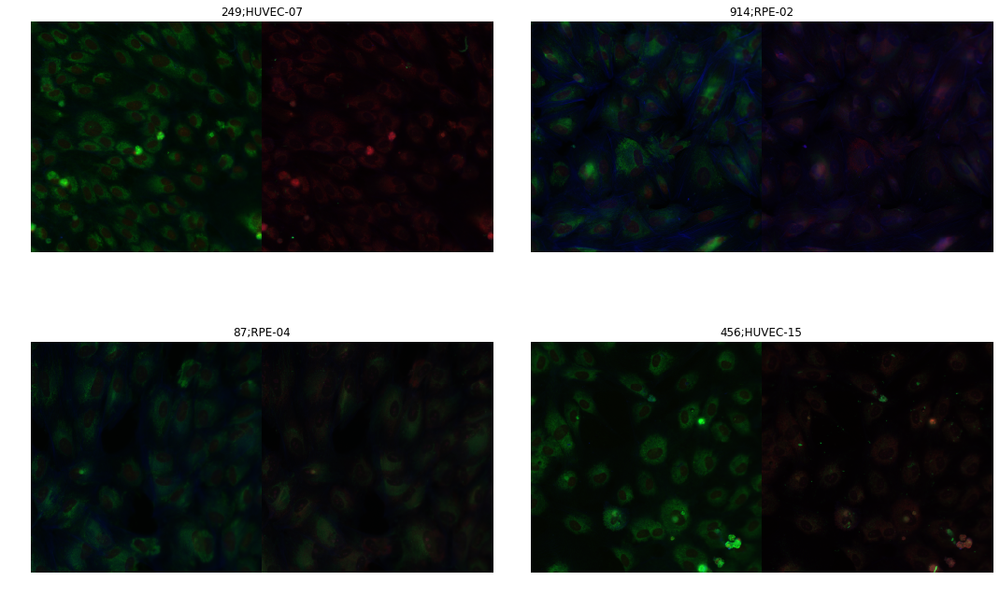

In [133]:
data_a.show_batch(rows=2)

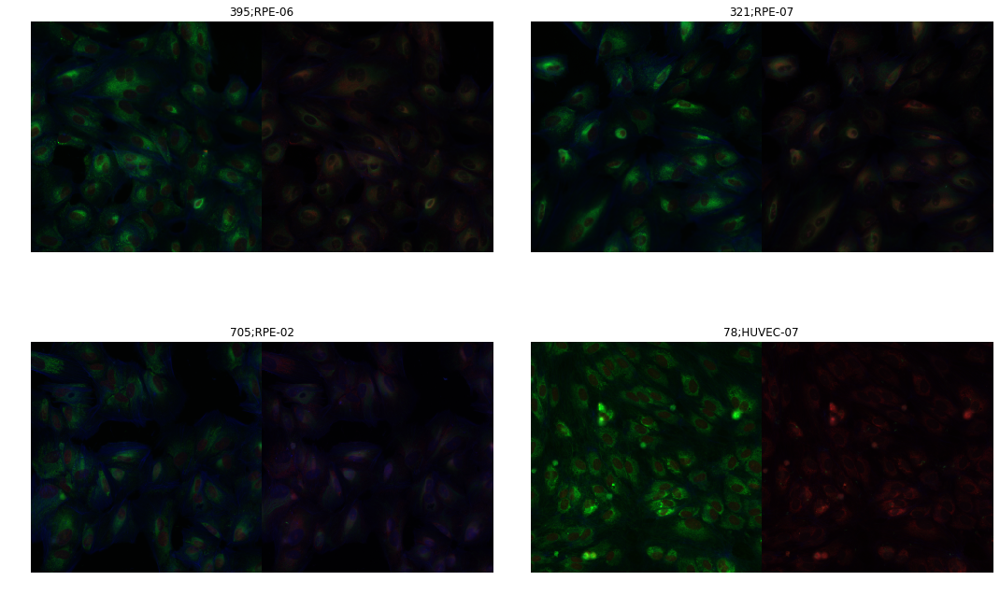

In [134]:
data_a.show_batch(rows=2)

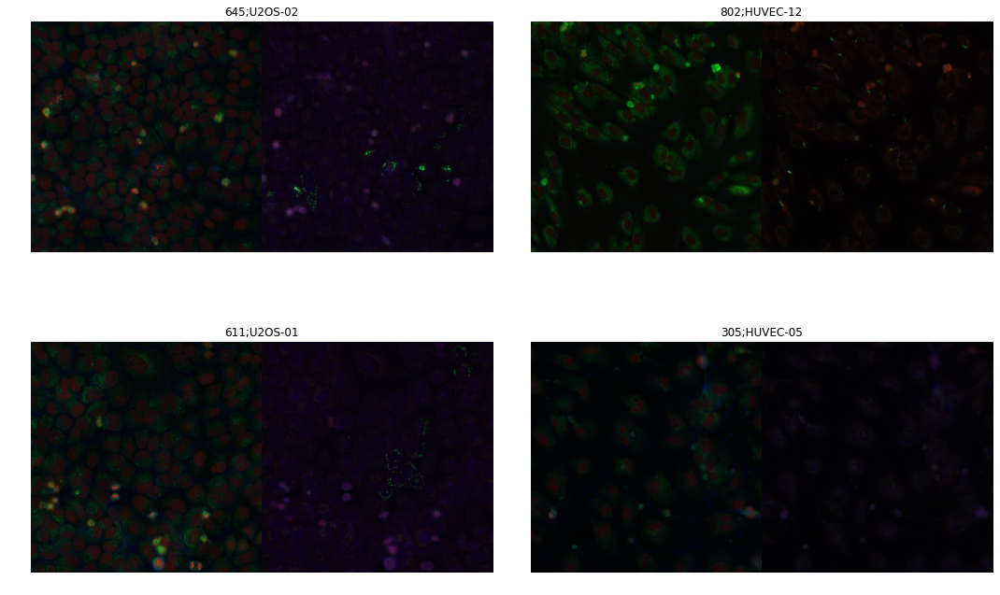

In [135]:
data_a.show_batch(rows=2)

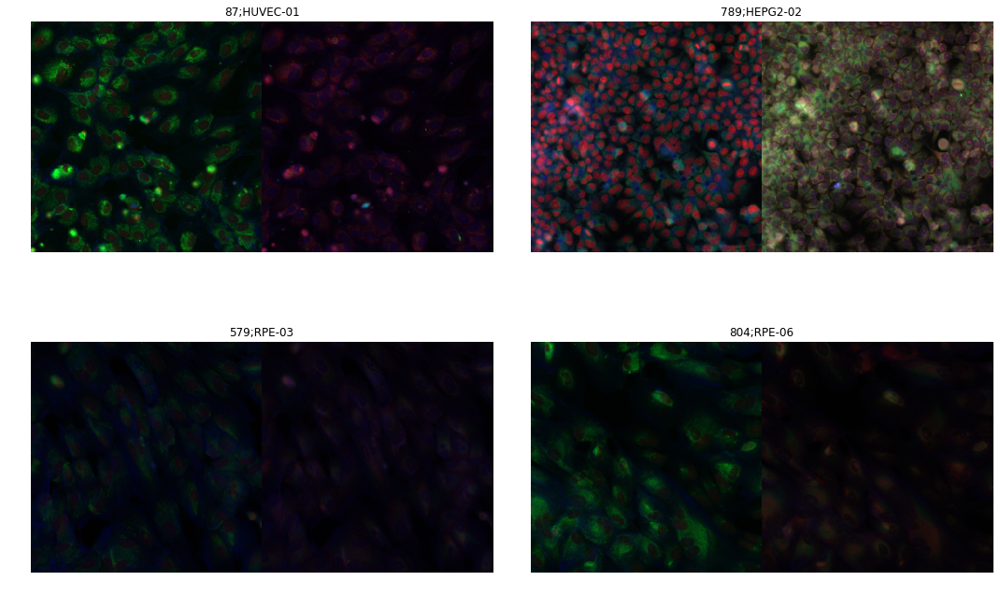

In [136]:
data_a.show_batch(rows=2)

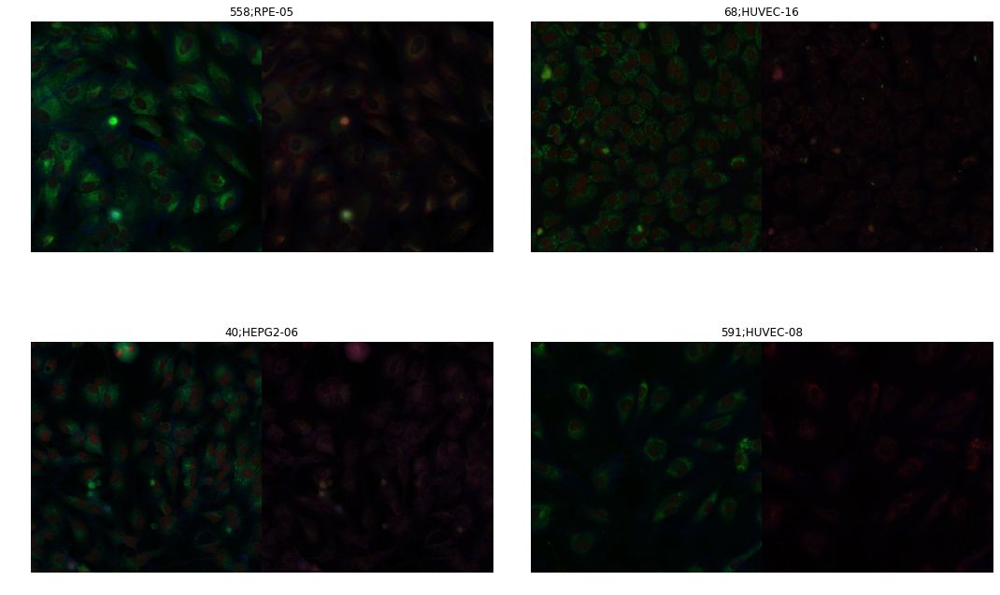

In [137]:
data_a.show_batch(rows=2)

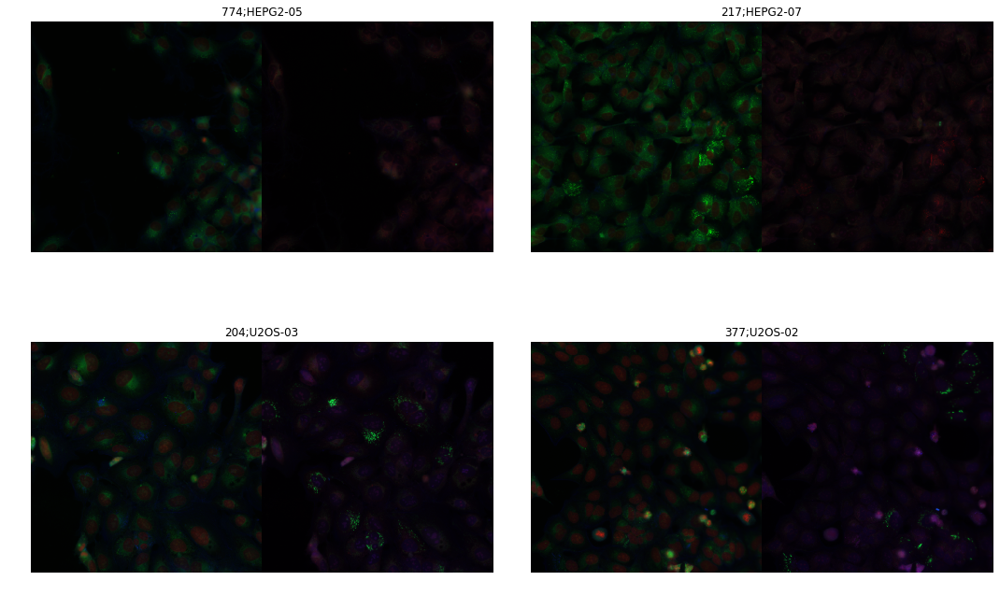

In [138]:
data_a.show_batch(rows=2)

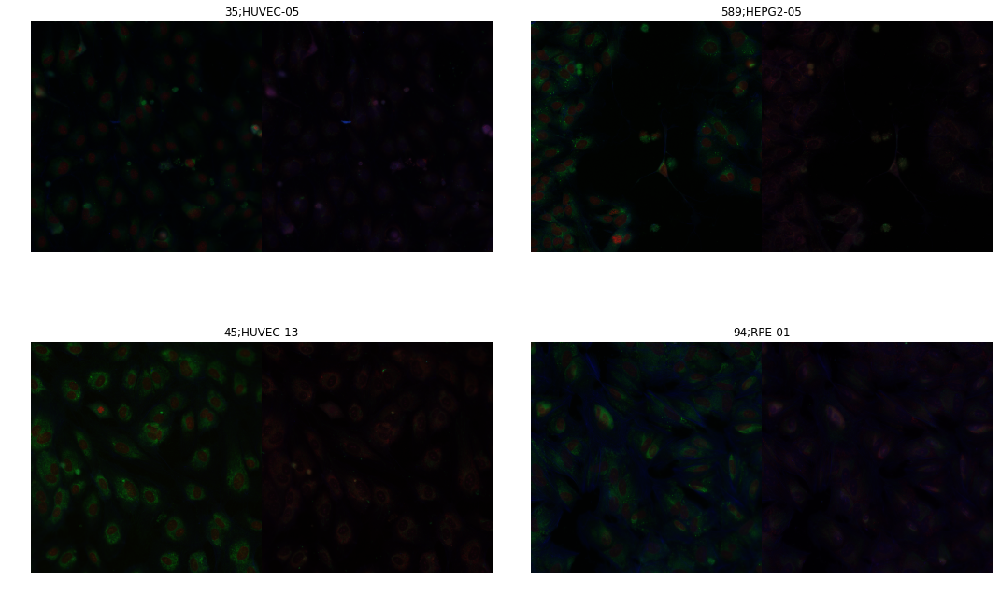

In [139]:
data_a.show_batch(rows=2)

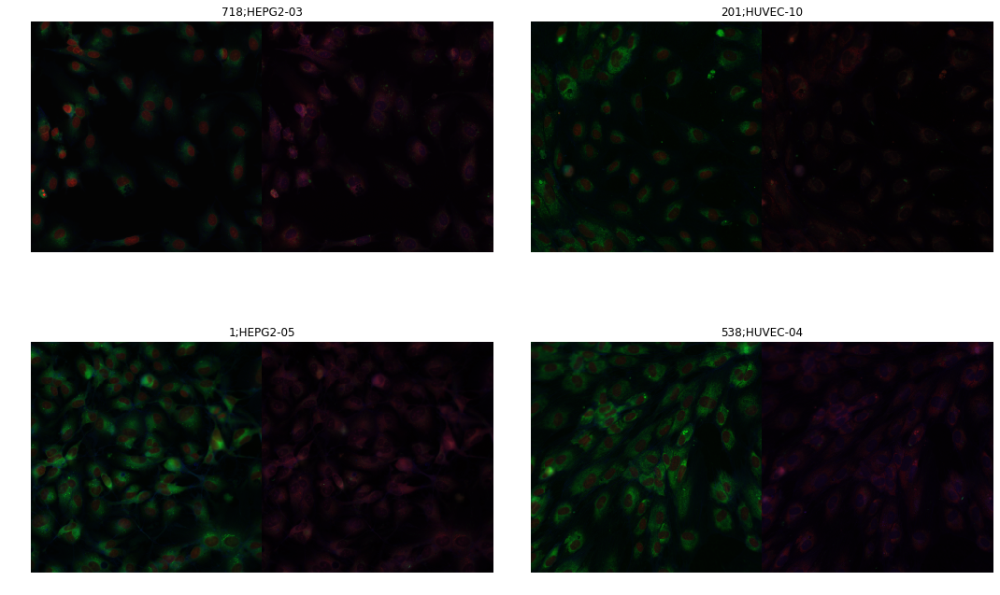

In [140]:
data_a.show_batch(rows=2)

## With additional color augmentation

In [141]:
tfms = get_transforms(xtra_tfms=color_augmentation())

In [142]:
data_a = (ImageList6D.from_df(df_train, path='train')
          .split_none()
          #.split_from_df(col=-1)
          .label_from_df(cols=-2, label_delim=' ') # label_delim=' ' for MultiCategoryList !
          .add_test(ImageList6D.from_df(df_train, path='train'))
          #.transform(size=sz)
          .transform(tfms, size=sz) # TFMS!
          .databunch(bs=bs))

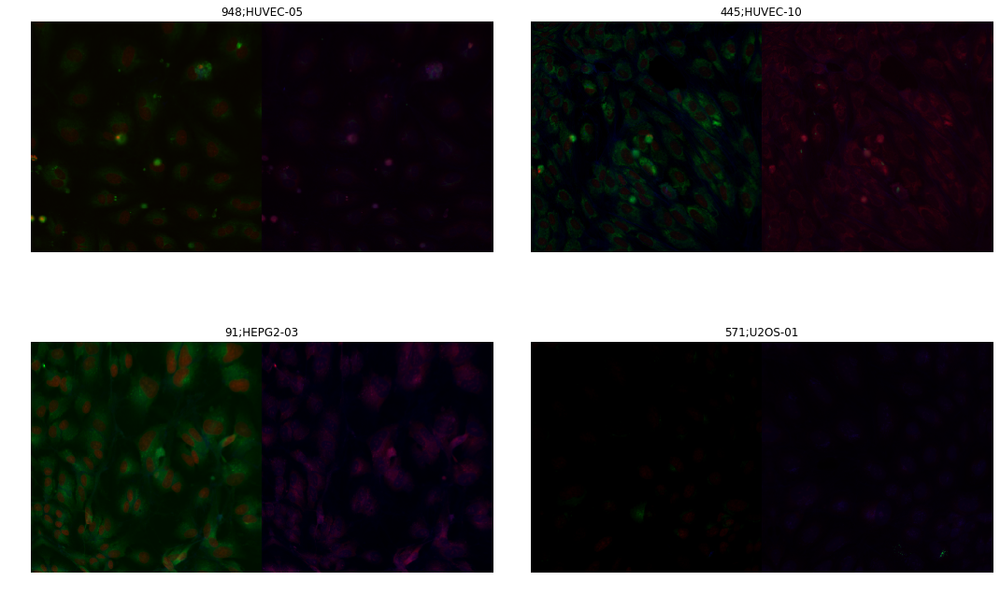

In [143]:
data_a.show_batch()

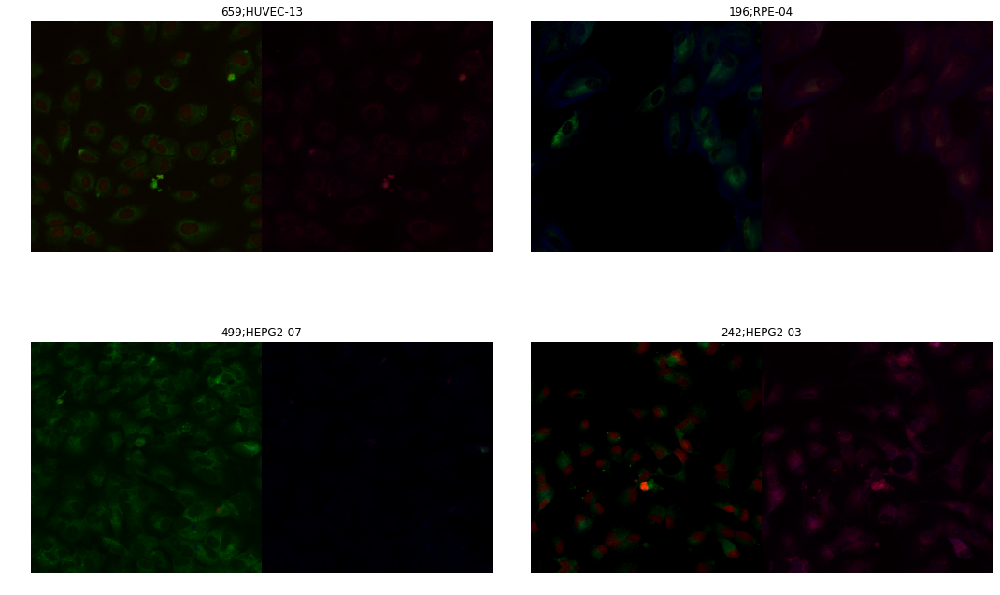

In [144]:
data_a.show_batch()

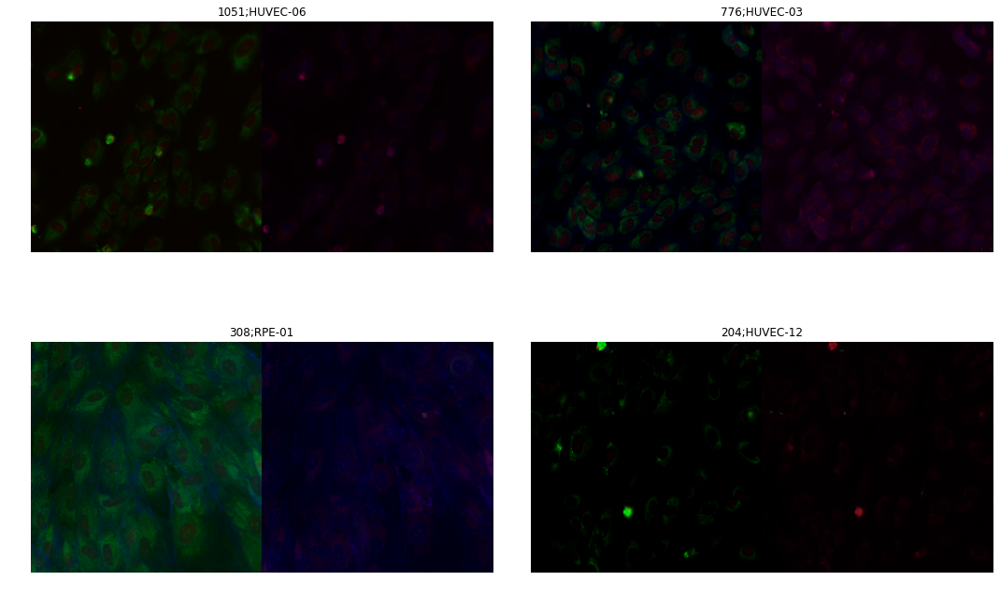

In [145]:
data_a.show_batch()

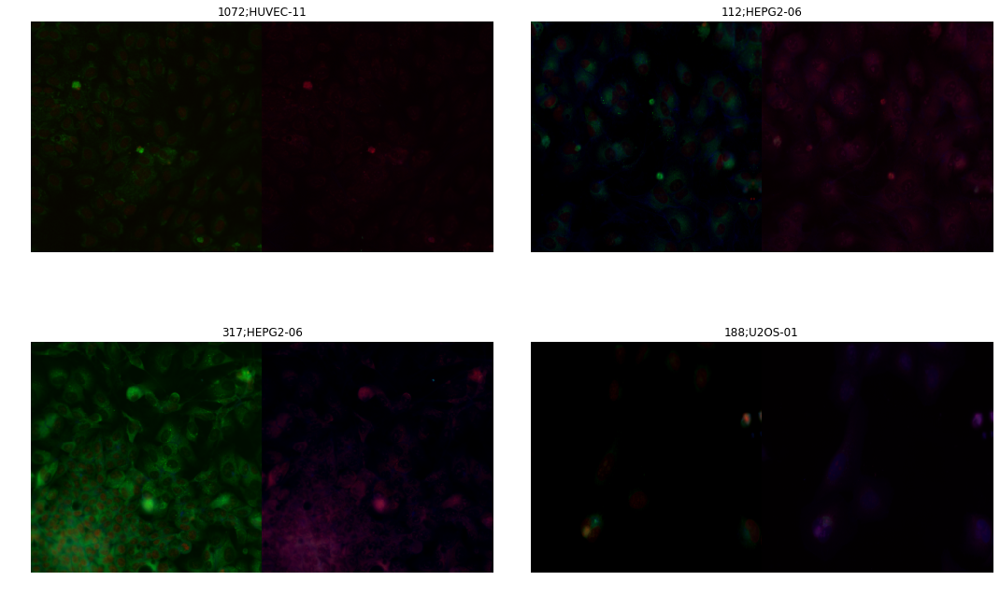

In [146]:
data_a.show_batch()

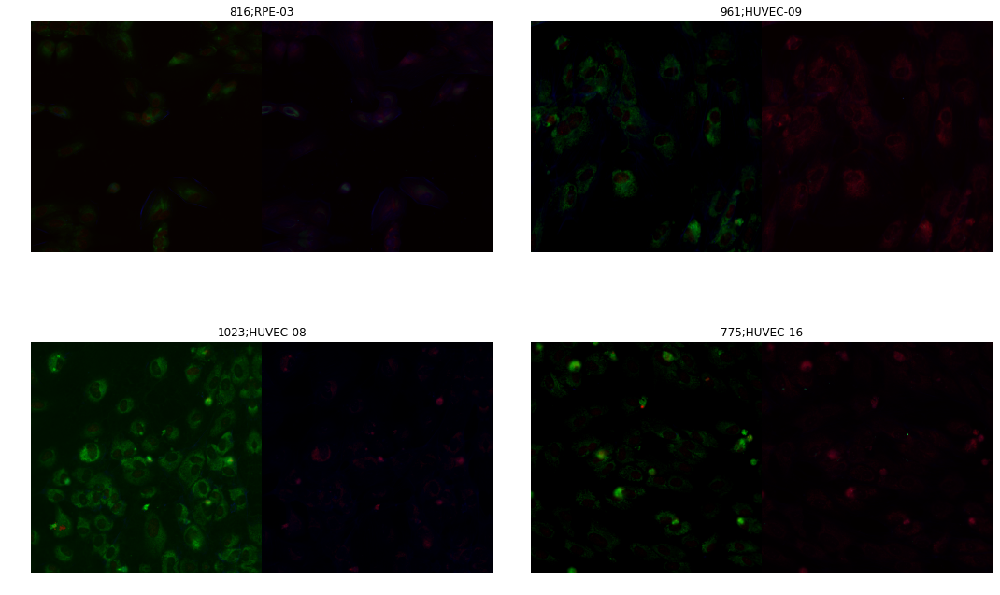

In [147]:
data_a.show_batch(rows=2)

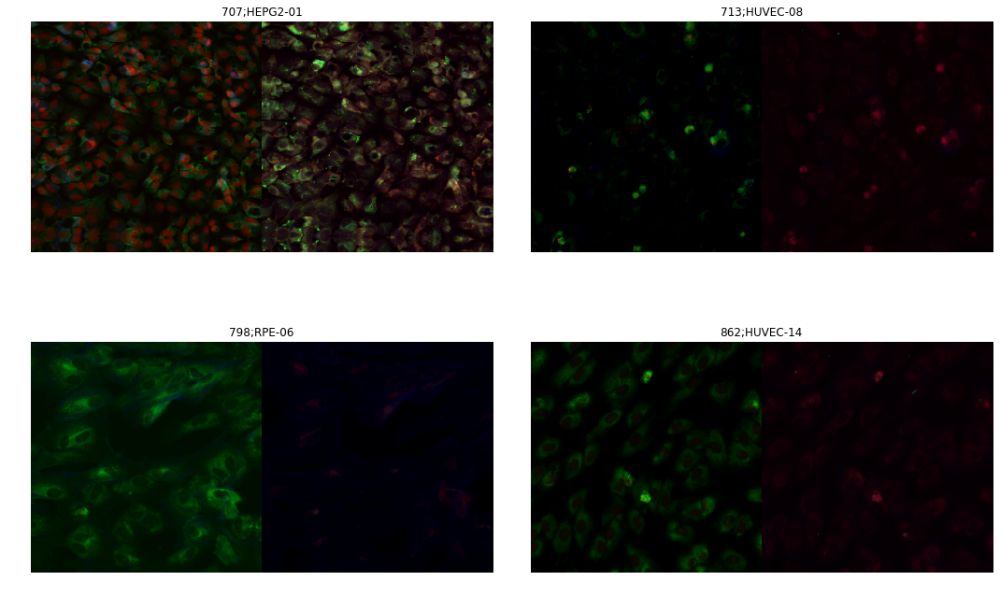

In [148]:
data_a.show_batch(rows=2)

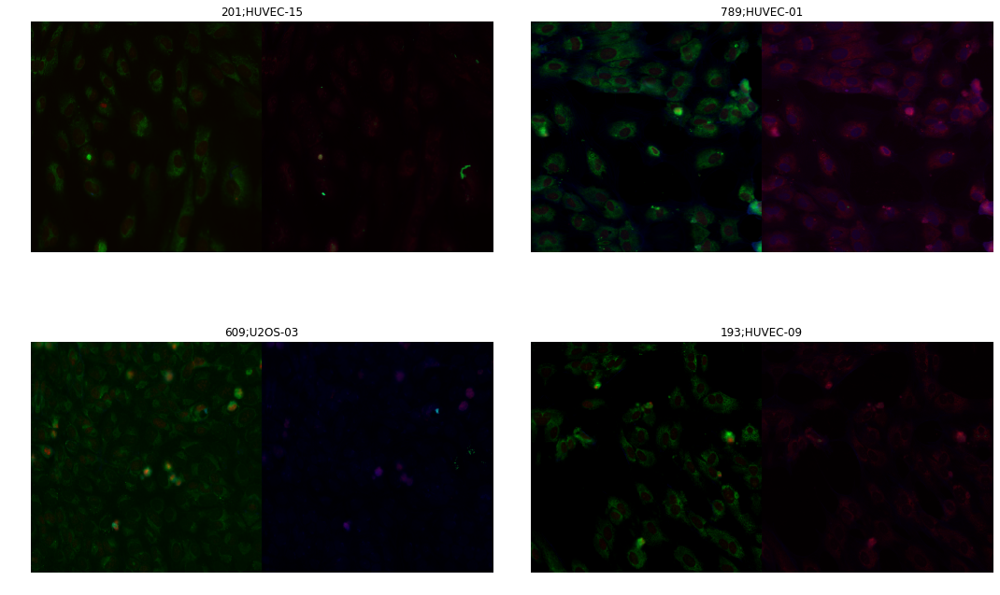

In [149]:
data_a.show_batch(rows=2)

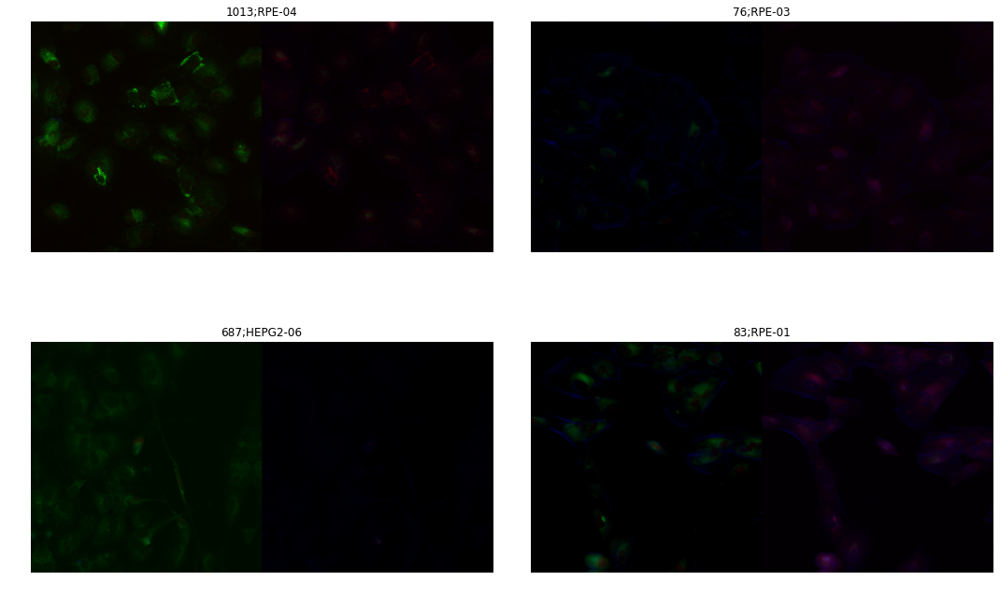

In [150]:
data_a.show_batch(rows=2)

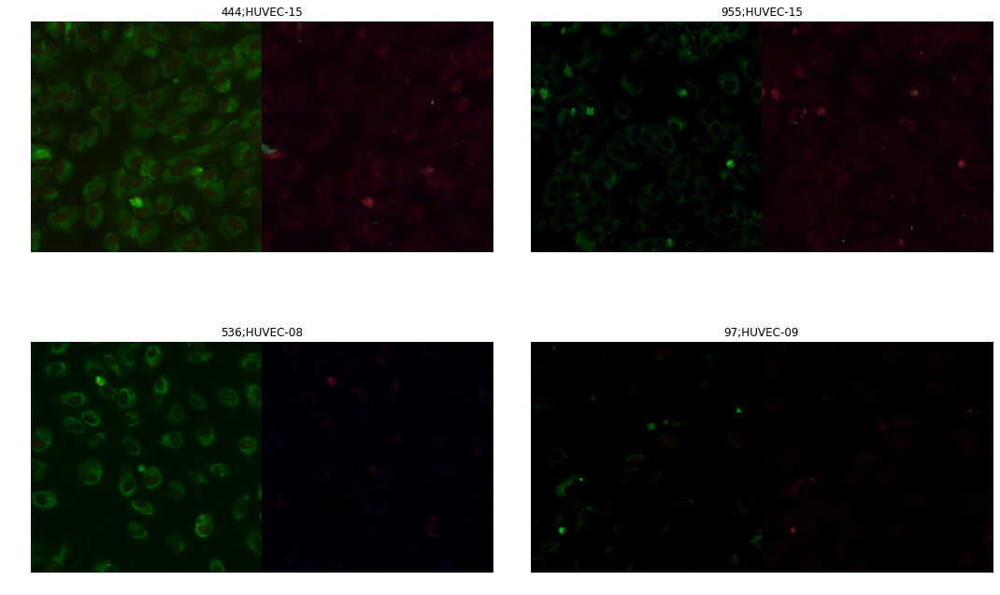

In [151]:
data_a.show_batch(rows=2)

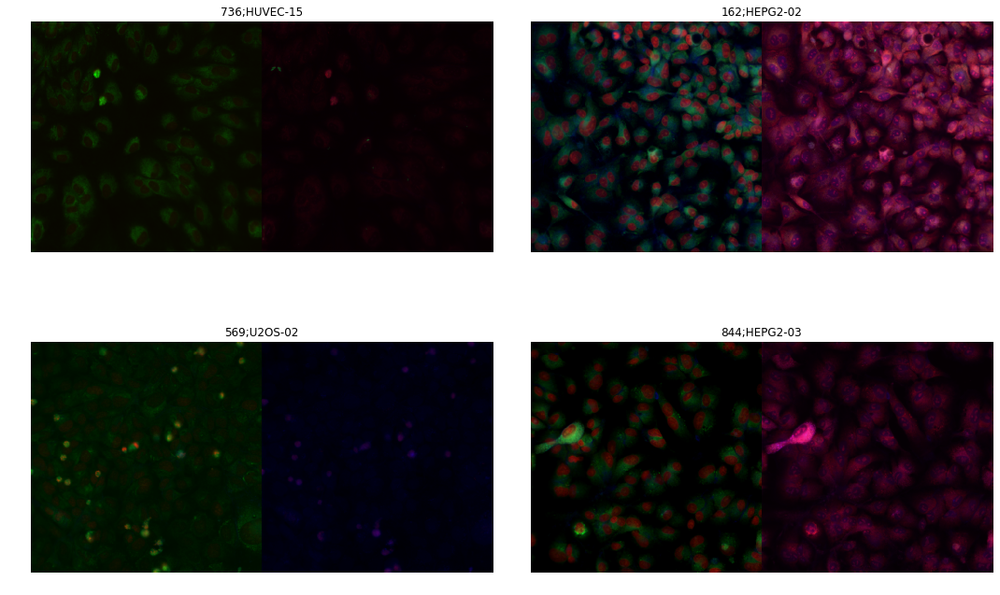

In [152]:
data_a.show_batch(rows=2)

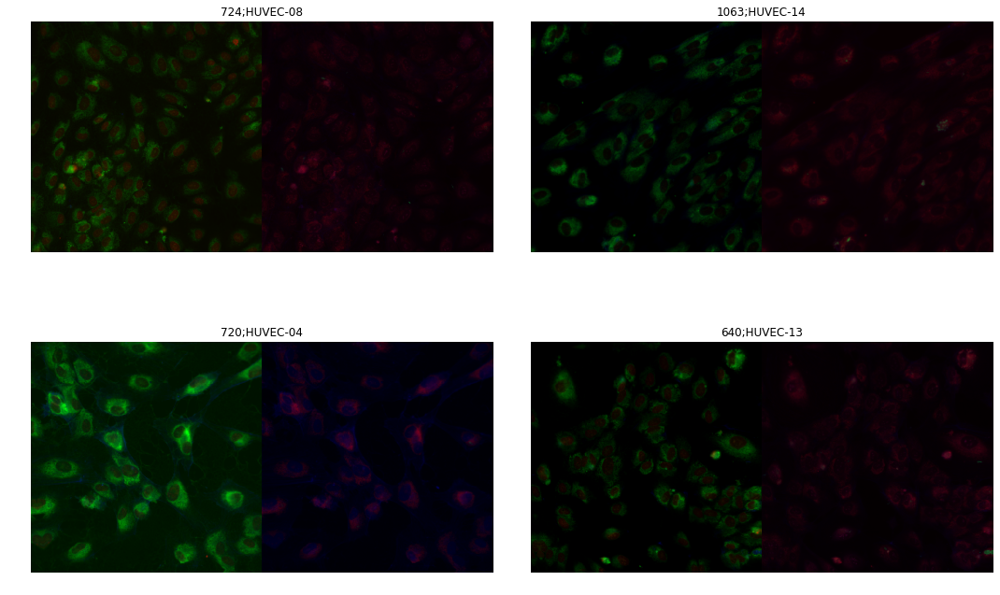

In [153]:
data_a.show_batch(rows=2)

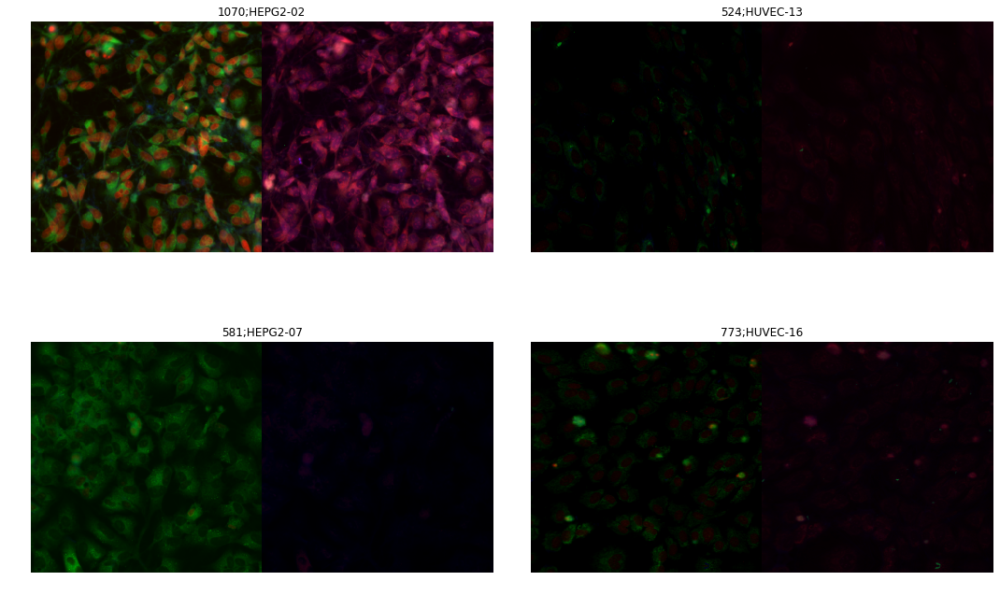

In [154]:
data_a.show_batch(rows=2)

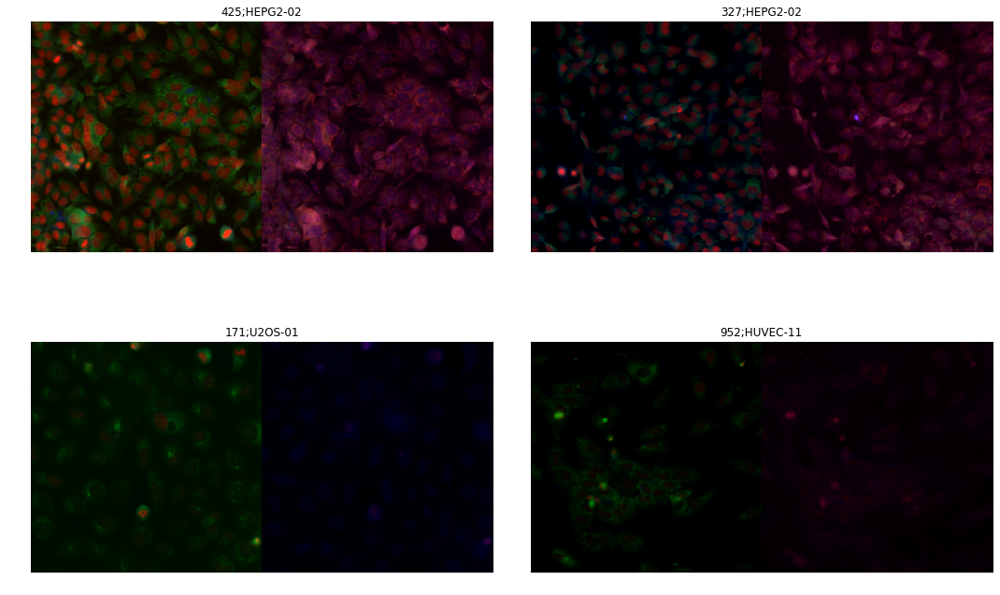

In [155]:
data_a.show_batch(rows=2)

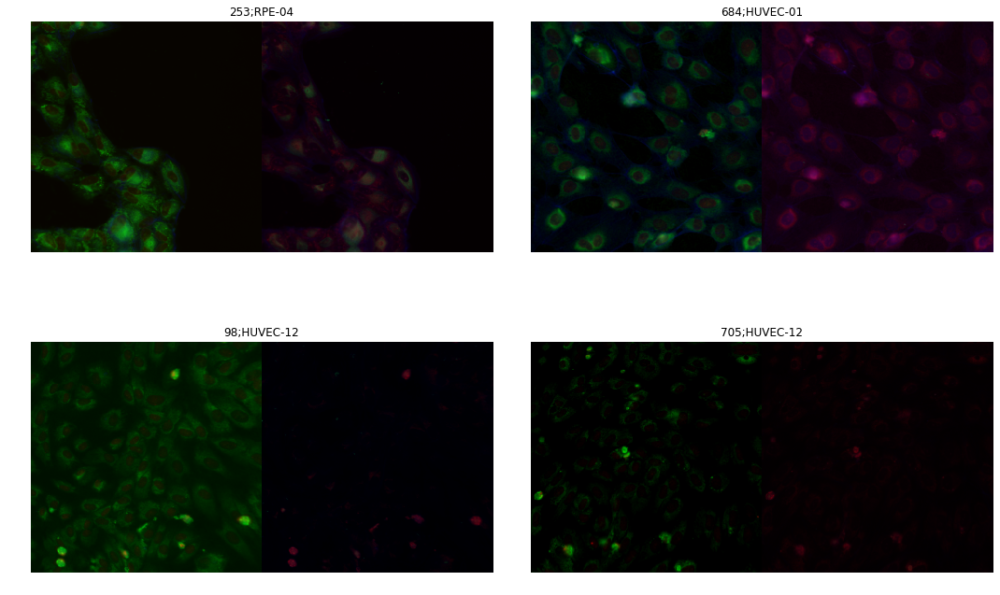

In [156]:
data_a.show_batch(rows=2)

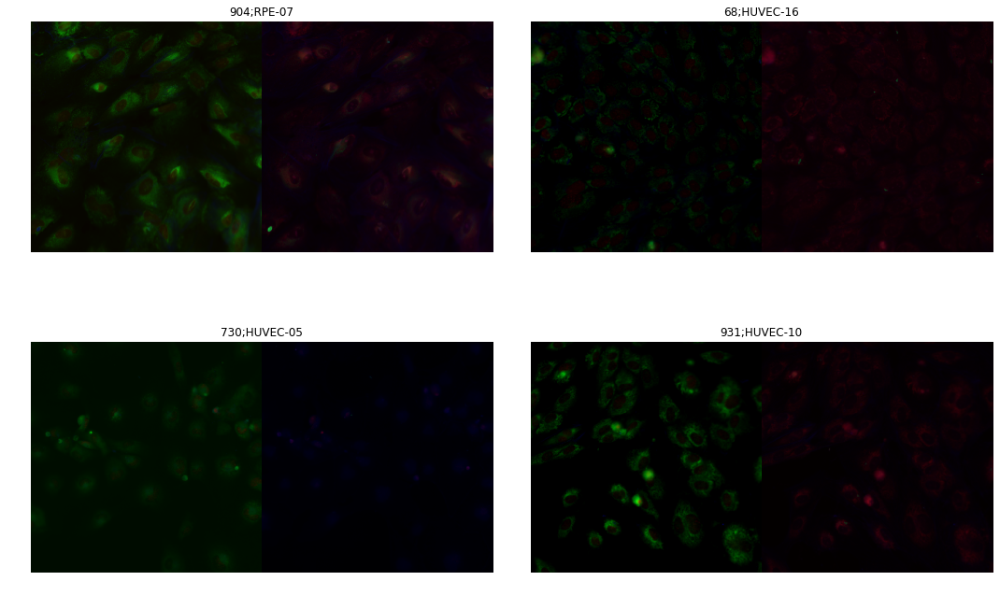

In [157]:
data_a.show_batch(rows=2)

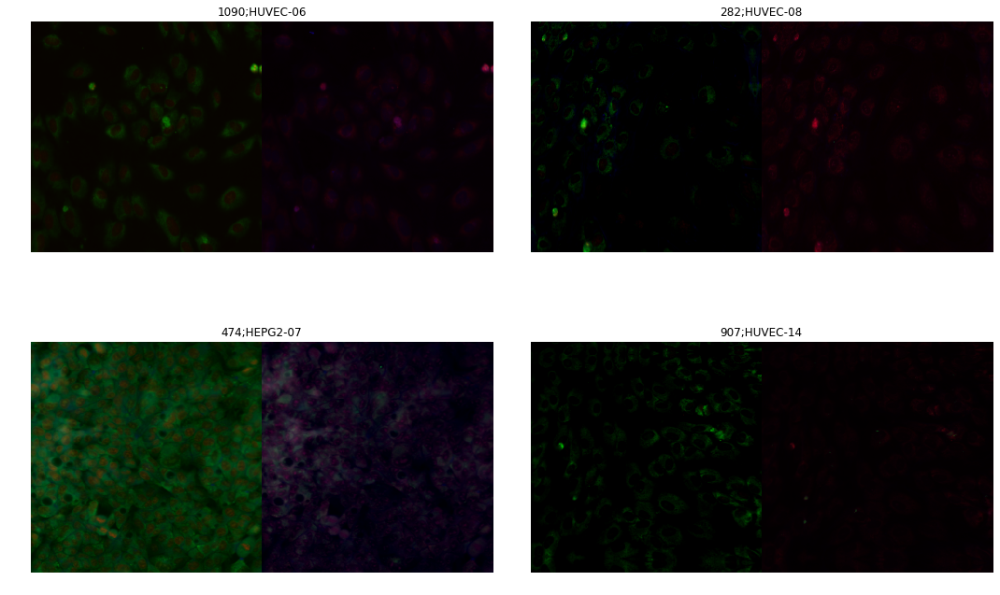

In [158]:
data_a.show_batch(rows=2)

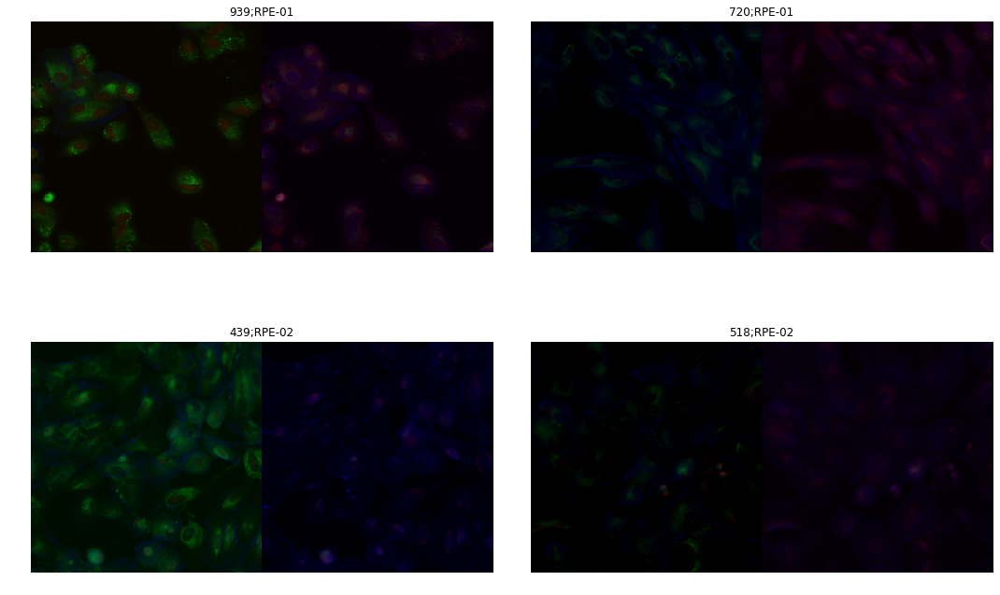

In [159]:
data_a.show_batch(rows=2)

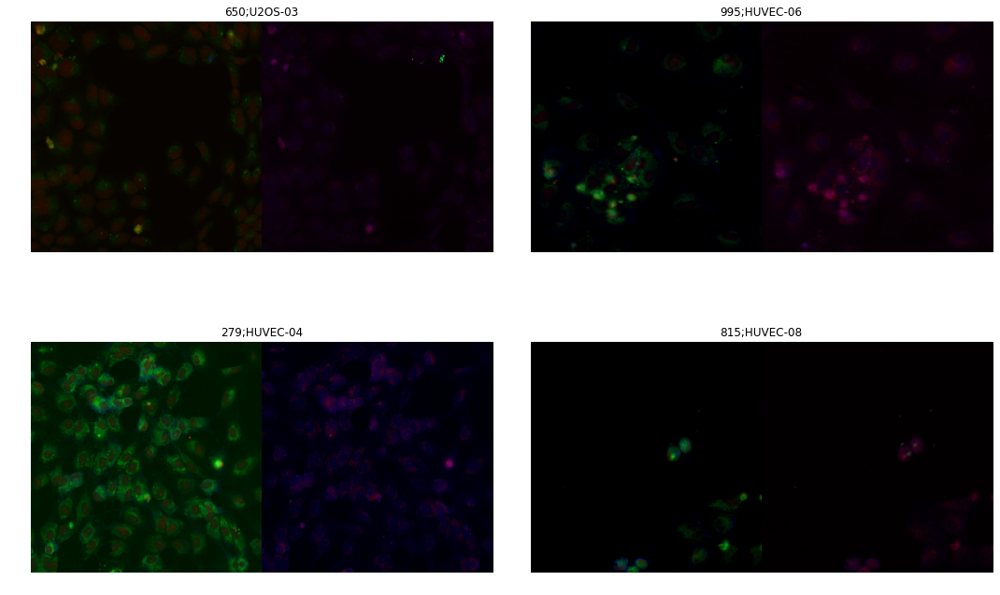

In [160]:
data_a.show_batch(rows=2)

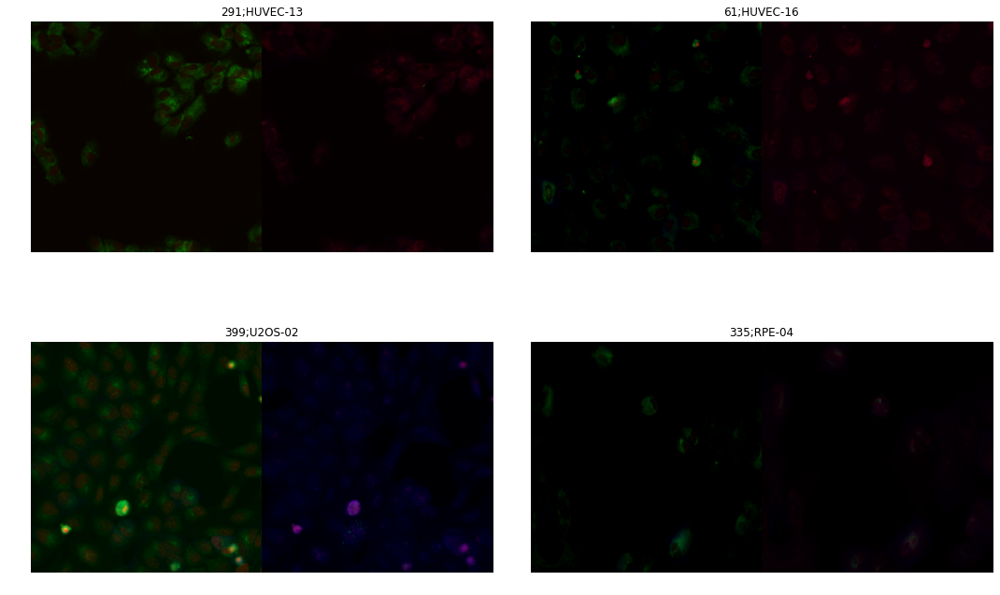

In [161]:
data_a.show_batch(rows=2)

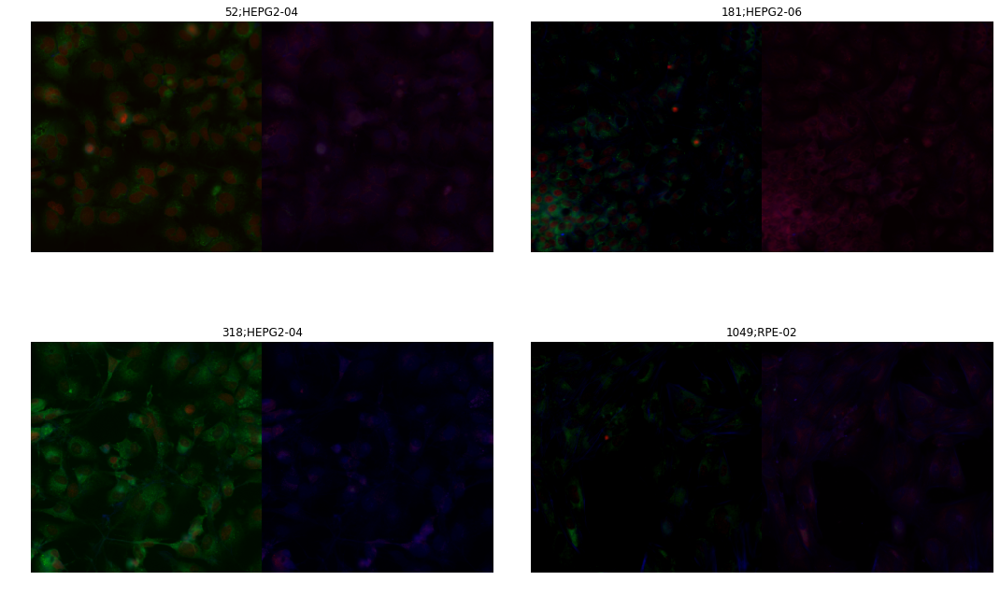

In [162]:
data_a.show_batch(rows=2)

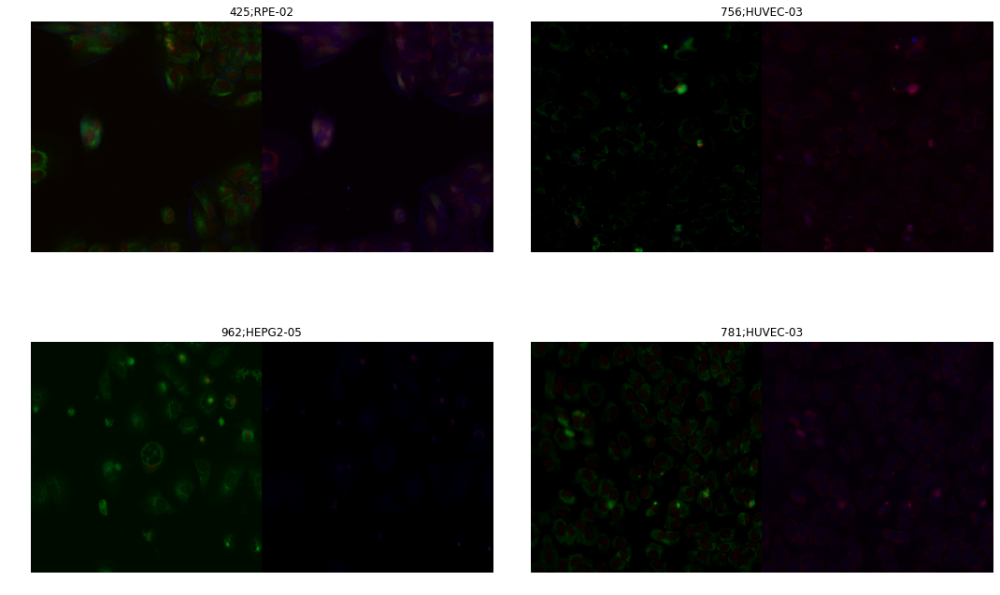

In [163]:
data_a.show_batch(rows=2)

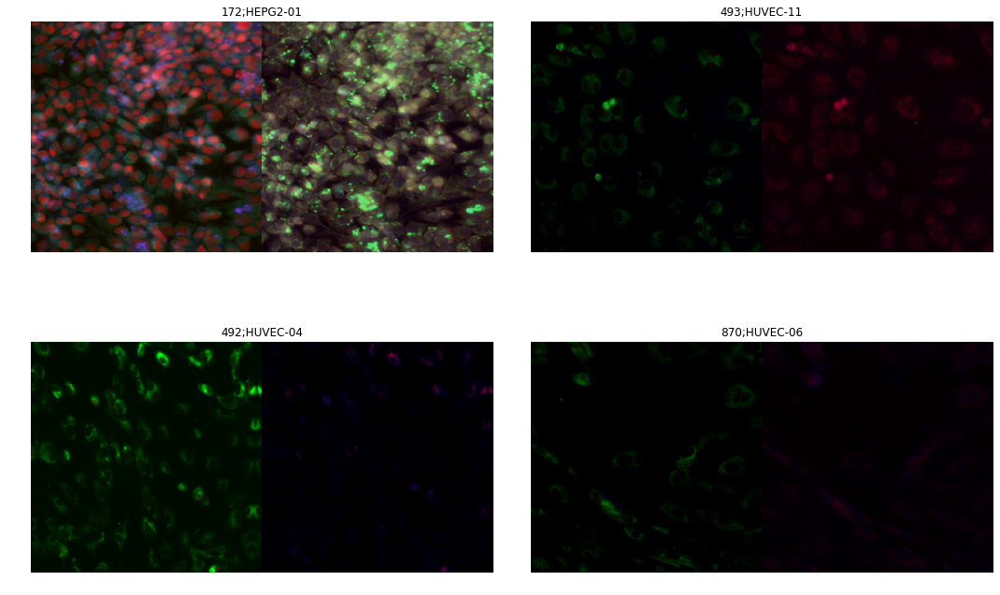

In [164]:
data_a.show_batch(rows=2)

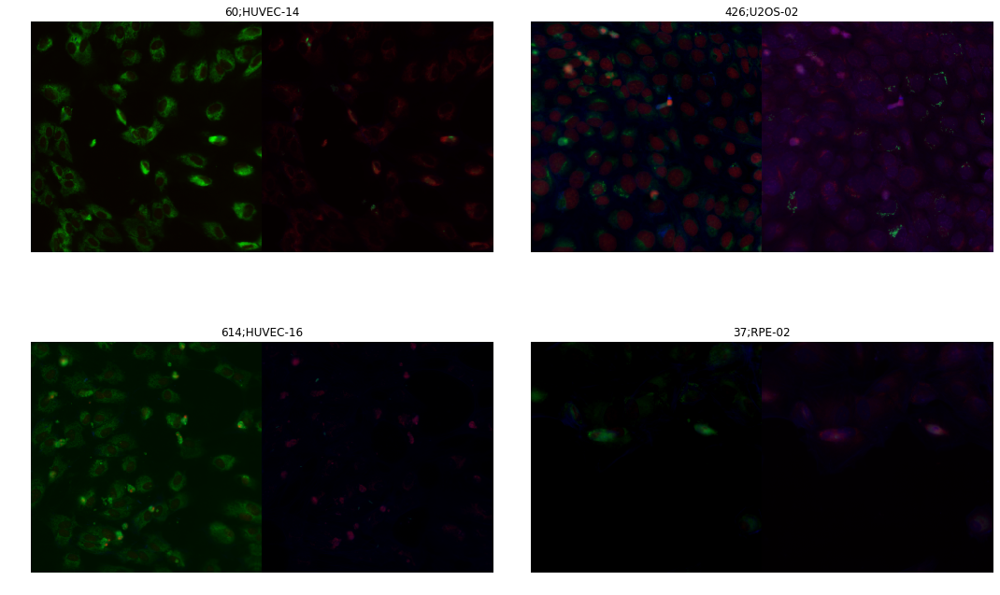

In [165]:
data_a.show_batch(rows=2)

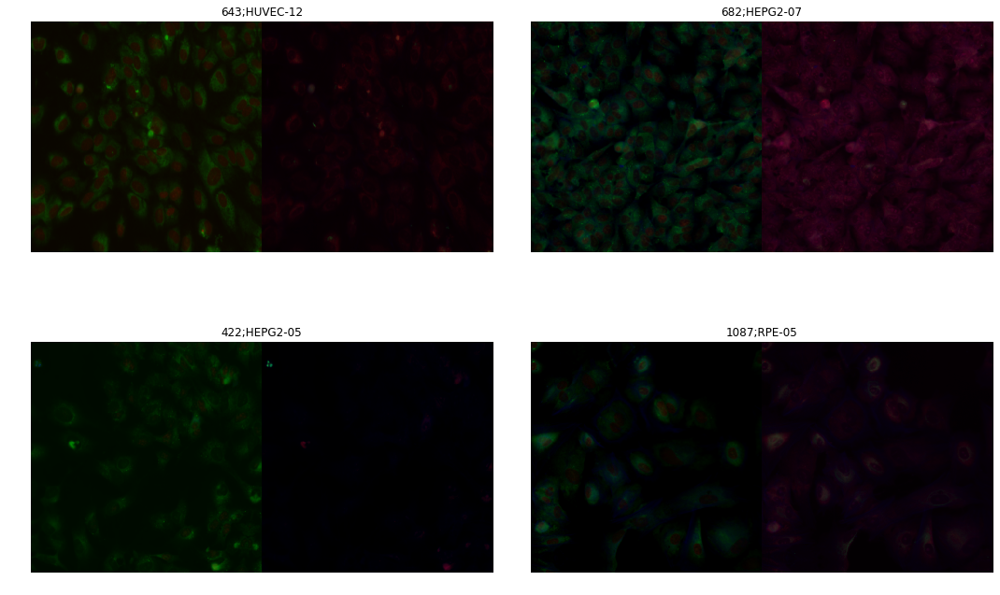

In [166]:
data_a.show_batch(rows=2)

# Pixel stats

In [92]:
pxstat = pd.read_csv('pixel_stats.csv')

In [102]:
pxstat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 753060 entries, 0 to 753059
Data columns (total 11 columns):
id_code       753060 non-null object
experiment    753060 non-null object
plate         753060 non-null int64
well          753060 non-null object
site          753060 non-null int64
channel       753060 non-null int64
mean          753060 non-null float64
std           753060 non-null float64
median        753060 non-null float64
min           753060 non-null int64
max           753060 non-null int64
dtypes: float64(3), int64(5), object(3)
memory usage: 63.2+ MB


In [93]:
pxstat.head()

,id_code,experiment,plate,well,site,channel,mean,std,median,min,max
0,HEPG2-01_1_B02,HEPG2-01,1,B02,1,1,71.063782,43.146240,67.0,7,255
1,HEPG2-01_1_B02,HEPG2-01,1,B02,1,2,32.174431,9.384594,31.0,6,98
2,HEPG2-01_1_B02,HEPG2-01,1,B02,1,3,61.836025,23.377997,59.0,11,255
3,HEPG2-01_1_B02,HEPG2-01,1,B02,1,4,56.983257,16.011435,56.0,11,156
4,HEPG2-01_1_B02,HEPG2-01,1,B02,1,5,91.671993,39.221836,85.0,13,255


In [115]:
pxstat.pivot_table(values=['min','max'], index='experiment', aggfunc=['min','max'])

min      max    
           max min  max min
experiment                 
HEPG2-01    36   1  255  23
HEPG2-02    38   1  255  19
HEPG2-03    22   1  255   6
HEPG2-04    14   0  255   3
HEPG2-05    18   0  255   9
HEPG2-06    21   0  255   4
HEPG2-07    15   0  255   5
HEPG2-08    14   0  255   9
HEPG2-09    12   0  255   2
HEPG2-10    19   0  255   5
HEPG2-11    15   0  255   6
HUVEC-01    20   0  255   7
HUVEC-02    25   0  255  10
HUVEC-03    22   0  255   7
HUVEC-04    23   0  255   8
HUVEC-05    23   0  255   4
HUVEC-06    11   0  255   5
HUVEC-07     6   0  255  11
HUVEC-08    18   0  255   7
HUVEC-09     2   0  255  53
HUVEC-10    14   0  255   7
HUVEC-11    21   0  255  10
HUVEC-12    13   0  255  46
HUVEC-13    18   0  255   9
HUVEC-14    17   0  255   9
HUVEC-15     5   0  255   8
HUVEC-16    18   0  255   5
HUVEC-17    18   0  255   5
HUVEC-18    22   0  255  11
HUVEC-19    12   0  255  11
HUVEC-20     2   0  255  11
HUVEC-21    18   1  255   7
HUVEC-22    12   0  255   8
HUVEC-23    18   0  255   6
HUVEC-24    13   0  255  11
RPE-01      14   0  255   7
RPE-02      15   0  255   5
RPE-03      16   0  255   6
RPE-04      16   0  255   6
RPE-05      15   0  255   4
RPE-06      14   0  255   4
RPE-07      19   0  255   4
RPE-08       6   0  255   7
RPE-09      17   0  255   6
RPE-10      14   0  255   7
RPE-11      14   0  255   6
U2OS-01     21   0  255   6
U2OS-02     20   0  255   9
U2OS-03     26   0  255   7
U2OS-04     53   1  255  19
U2OS-05     18   0  255   6

In [116]:
pxstat['min_norm'] = pxstat['min']/255
pxstat['max_norm'] = pxstat['max']/255

In [117]:
pxstat_minmax = pxstat.pivot_table(values=['min_norm','max_norm'], index='experiment', aggfunc=['min','max'])

In [118]:
pxstat_minmax

min                max          
            max_norm  min_norm max_norm  min_norm
experiment                                       
HEPG2-01    0.141176  0.003922      1.0  0.090196
HEPG2-02    0.149020  0.003922      1.0  0.074510
HEPG2-03    0.086275  0.003922      1.0  0.023529
HEPG2-04    0.054902  0.000000      1.0  0.011765
HEPG2-05    0.070588  0.000000      1.0  0.035294
HEPG2-06    0.082353  0.000000      1.0  0.015686
HEPG2-07    0.058824  0.000000      1.0  0.019608
HEPG2-08    0.054902  0.000000      1.0  0.035294
HEPG2-09    0.047059  0.000000      1.0  0.007843
HEPG2-10    0.074510  0.000000      1.0  0.019608
HEPG2-11    0.058824  0.000000      1.0  0.023529
HUVEC-01    0.078431  0.000000      1.0  0.027451
HUVEC-02    0.098039  0.000000      1.0  0.039216
HUVEC-03    0.086275  0.000000      1.0  0.027451
HUVEC-04    0.090196  0.000000      1.0  0.031373
HUVEC-05    0.090196  0.000000      1.0  0.015686
HUVEC-06    0.043137  0.000000      1.0  0.019608
HUVEC-07    0.023529  0.000000      1.0  0.043137
HUVEC-08    0.070588  0.000000      1.0  0.027451
HUVEC-09    0.007843  0.000000      1.0  0.207843
HUVEC-10    0.054902  0.000000      1.0  0.027451
HUVEC-11    0.082353  0.000000      1.0  0.039216
HUVEC-12    0.050980  0.000000      1.0  0.180392
HUVEC-13    0.070588  0.000000      1.0  0.035294
HUVEC-14    0.066667  0.000000      1.0  0.035294
HUVEC-15    0.019608  0.000000      1.0  0.031373
HUVEC-16    0.070588  0.000000      1.0  0.019608
HUVEC-17    0.070588  0.000000      1.0  0.019608
HUVEC-18    0.086275  0.000000      1.0  0.043137
HUVEC-19    0.047059  0.000000      1.0  0.043137
HUVEC-20    0.007843  0.000000      1.0  0.043137
HUVEC-21    0.070588  0.003922      1.0  0.027451
HUVEC-22    0.047059  0.000000      1.0  0.031373
HUVEC-23    0.070588  0.000000      1.0  0.023529
HUVEC-24    0.050980  0.000000      1.0  0.043137
RPE-01      0.054902  0.000000      1.0  0.027451
RPE-02      0.058824  0.000000      1.0  0.019608
RPE-03      0.062745  0.000000      1.0  0.023529
RPE-04      0.062745  0.000000      1.0  0.023529
RPE-05      0.058824  0.000000      1.0  0.015686
RPE-06      0.054902  0.000000      1.0  0.015686
RPE-07      0.074510  0.000000      1.0  0.015686
RPE-08      0.023529  0.000000      1.0  0.027451
RPE-09      0.066667  0.000000      1.0  0.023529
RPE-10      0.054902  0.000000      1.0  0.027451
RPE-11      0.054902  0.000000      1.0  0.023529
U2OS-01     0.082353  0.000000      1.0  0.023529
U2OS-02     0.078431  0.000000      1.0  0.035294
U2OS-03     0.101961  0.000000      1.0  0.027451
U2OS-04     0.207843  0.003922      1.0  0.074510
U2OS-05     0.070588  0.000000      1.0  0.023529

In [119]:
# CA tfms too much? Looks also from the pictures like it?